## Using MiloR to do DA analysis 3.18

In [1]:
import anndata as ad
import matplotlib.pyplot as plt
import muon as mu
import pandas as pd
import scanpy as sc
import numpy as np
import scirpy as ir
import matplotlib as mpl
from scipy.sparse import csr_matrix
import matplotlib.ticker as ticker
mpl.rcParams['font.family'] = 'Arial'
figPath = "NKTCL-figure-2.18"
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["axes.unicode_minus"] = False
plt.rcParams["font.size"] = 14

/home/rzh/BCY/lib/python3.10/site-packages/setuptools_scm/_integration/setuptools.py:30: RuntimeWarning: 
ERROR: setuptools==59.6.0 is used in combination with setuptools_scm>=8.x

Your build configuration is incomplete and previously worked by accident!
setuptools_scm requires setuptools>=61

Suggested workaround if applicable:
 - migrating from the deprecated setup_requires mechanism to pep517/518
   and using a pyproject.toml to declare build dependencies
   which are reliably pre-installed before running the build tools

  warnings.warn(


In [2]:
adata_NK = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-NK-4.5.h5ad")

In [45]:
adata_CD8T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.4.h5ad")

In [54]:
adata_CD4T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-4.4.h5ad")

In [ ]:
adata_T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-4.4.h5ad")

In [340]:
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

In [341]:
anndata2ri.activate()

/tmp/ipykernel_2061101/4016445965.py:1: DeprecationWarning: The global conversion available with activate() is deprecated and will be removed in the next major release. Use a local converter.
  anndata2ri.activate()


In [342]:
%load_ext rpy2.ipython

In [336]:
def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata

def prepare_miloR(adata:ad.AnnData, conDict:dict, condName, condVal, batch='batch'):
  adata_no_knn = adata.copy()
  adata_no_knn.obsp = None
  adata_no_knn.uns.pop("neighbors")
  adata_no_knn = anno(adata_no_knn, annoDict=conDict, obsKey=condName, obsVal=condVal, default=None)
  adata_no_knn.obs[condName] = adata_no_knn.obs[condName].astype('category')
  used_cond = adata_no_knn.obs[condName].cat.categories
  adata_no_knn = adata_no_knn[adata_no_knn.obs[condName].isin(used_cond)]  # only use conditions condDict 
  print(adata_no_knn.obs[condName].cat.categories)
  knn_adjacency = adata.obsp["connectivities"]
  design_df = adata_no_knn.obs[[batch,condName]]
  design_df.drop_duplicates(inplace=True)
  design_df.index = design_df['batch']
  return adata_no_knn, knn_adjacency, design_df

In [379]:
adata_NK.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-NK-4.5.h5ad")

In [293]:
adata_NK.obs['anno-NK'].cat.categories

Index(['C01_NK_MKI67', 'C02_NK_CD56', 'C03_NK_CD16', 'C04_NK_CD200R1',
       'C05_NKT_FGFBP2', 'C06_NK_KIT', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'],
      dtype='object')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


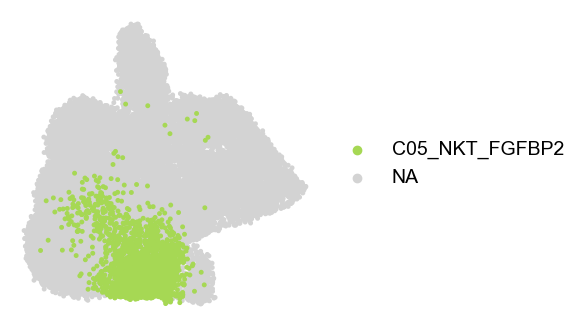

In [312]:
adata_NK.obs['anno-focus'] = adata_NK[adata_NK.obs['anno-NK'].isin(['C05_NKT_FGFBP2',])].obs['anno-NK']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_NK[adata_NK.obs['treatment'].isin(['Pre'])],color=['anno-focus'], size=50,
           alpha=1, title='', ax=ax, show=False, palette=['#a6d854', 'lightgray'])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_NK_Pre.png', dpi=400, bbox_inches='tight')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


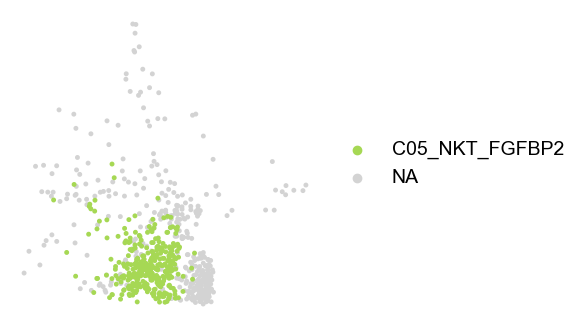

In [313]:
adata_NK.obs['anno-focus'] = adata_NK[adata_NK.obs['anno-NK'].isin(['C05_NKT_FGFBP2',])].obs['anno-NK']
fig, ax = plt.subplots(1, 1, figsize=(4, 4))
sc.pl.umap(adata_NK[adata_NK.obs['treatment'].isin(['Post'])],color=['anno-focus'], size=50,
           alpha=1, title='', ax=ax, show=False, palette=['#a6d854', 'lightgray'])
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.set_xlabel("")
ax.set_ylabel("")
fig.savefig(f'{figPath}/EBV-anno_NK_Post.png', dpi=400, bbox_inches='tight')

In [309]:
adata1 = adata_NK[adata_NK.obs['treatment'].isin(['Pre'])]
len(adata1[adata1.obs['anno-NK'].isin(['C05_NKT_FGFBP2',])]), len(adata1)

(1798, 22556)

In [334]:
adata_T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-T-4.18.h5ad")
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

In [308]:
adata1 = adata_NK[adata_NK.obs['treatment'].isin(['Post'])]
len(adata1[adata1.obs['anno-NK'].isin(['C05_NKT_FGFBP2',])]), len(adata1)

(345, 721)

In [360]:
adata_NK1 = adata_NK[adata_NK.obs['batch'].isin(['NK11_0', 'NK11_1','NK5_0', 'NK5_1', 'NK6_0', 'NK6_1', 'NK7_0', 'NK7_1', 'NK8_0', 'NK8_1', 'PB9_0'])]
conDict = {
  'left': ['Pre',],
  'right': ['Post', 'PBMC']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_NK1, conDict, 'TorN', 'treatment')

Index(['left', 'right'], dtype='object')


/tmp/ipykernel_2061101/2067485073.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  design_df.drop_duplicates(inplace=True)


In [ ]:
conDict = {
  'left': ['Pre',],
  'right': ['Post', 'PBMC']
}
adata_no_knn, knn_adjacency, design_df = prepare_miloR(adata_T, conDict, 'TorN', 'treatment')

In [361]:
%%R -i adata_no_knn
library(miloR)
library(igraph)
library(ggplot2)
library(ggbeeswarm)
library(colorspace)
milo <- Milo(adata_no_knn)

In [93]:
%%R
milo <- milo.CD8T

In [407]:
%%R
milo <- milo.T

In [85]:
%%R
milo <- milo.CD4T.5v5

In [362]:
%%R -i knn_adjacency
milo_graph <- buildFromAdjacency(knn_adjacency, k=20, is.binary=TRUE)
graph(milo) <- miloR::graph(milo_graph)

milo <- buildGraph(milo, k=20, d=30)

## Define neighbourhoods
milo <- makeNhoods(milo, prop = 0.1, k = 20, d=30, refined = TRUE)
## Count cells in neighbourhoods
milo <- countCells(milo, meta.data = data.frame(colData(milo)), sample="batch")

## Calculate distances between cells in neighbourhoods
## for spatial FDR correction
milo <- calcNhoodDistance(milo, d=30)

Constructing kNN graph with k:20
Checking valid object
Running refined sampling with reduced_dim
Checking meta.data validity
Counting cells in neighbourhoods


In [419]:
%%R -i design_df -o DA_T

## Test for differential abundance
DA_T <- testNhoods(milo, design = ~ TorN, design.df = design_df)

Using TMM normalisation
Performing spatial FDR correction withk-distance weighting


In [421]:
%%R -i design_df -o DA_T
## Annotate differential abundance
# milo <- buildNhoodGraph(milo)
DA_T <- annotateNhoods(milo, DA_T, coldata_col = "anno.subTfixed")

In [423]:
DA_T1 = DA_T.copy()

In [ ]:
%%R -i design_df -o DA_results

## Test for differential abundance
DA_results <- testNhoods(milo, design = ~ TorN, design.df = design_df)

## Annotate differential abundance
milo <- buildNhoodGraph(milo)
DA_results <- annotateNhoods(milo, DA_results, coldata_col = "anno.NK")

In [ ]:
DA_T = DA_results

In [349]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

In [424]:
DA_T = DA_T[DA_T['anno.subTfixed'].isin([ 'C04_pTex_IFNG','C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3','C12_Tprol_MKI67','C13_Malig_MSI2'])]
DA_T

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,anno.subTfixed,anno.subTfixed_fraction
1,5.447120,8.587286,13.572184,0.000230,0.004601,1.0,0.004592,C06_tTex_CD8,0.581395
3,2.780314,9.643214,2.140958,0.143418,0.230406,3.0,0.225736,C06_tTex_CD8,0.491935
6,-4.908530,8.748055,7.057108,0.007897,0.035131,6.0,0.034481,C07_tTex_CD4,0.942857
12,1.945503,9.167352,1.269874,0.259795,0.347637,12.0,0.341132,C12_Tprol_MKI67,0.640000
16,4.855184,9.020590,7.825410,0.005153,0.035131,16.0,0.034481,C08_Treg_FOXP3,0.918033
...,...,...,...,...,...,...,...,...,...
3905,5.168279,8.966315,9.031350,0.002655,0.028034,3905.0,0.028200,C08_Treg_FOXP3,0.623188
3909,-4.163343,8.382115,6.173800,0.012968,0.042497,3909.0,0.041697,C04_pTex_IFNG,0.652174
3911,-5.558145,9.148864,7.213821,0.007236,0.035131,3911.0,0.034481,C05_tTex_TCF7,0.500000
3912,0.358899,8.988719,0.043739,0.834341,0.861638,3912.0,0.859192,C13_Malig_MSI2,0.958333


In [393]:
DA_NK = DA_results_backup1

In [394]:
DA_NK = DA_NK[DA_NK['anno.NK'].isin([ 'C05_NKT_FGFBP2', 'C07_Malig_IL2RA', 'C08_Malig_H2AC11'])]

In [366]:
DA_results_backup1 = DA_results.copy()

In [369]:
DA_results = DA_results_backup1

In [426]:
DA_T.columns = ['logFC', 'logCPM', 'F', 'PValue', 'FDR', 'Nhood', 'SpatialFDR',
                'anno', 'anno_fraction']
DA_NK.columns = ['logFC', 'logCPM', 'F', 'PValue', 'FDR', 'Nhood', 'SpatialFDR',
                'anno', 'anno_fraction']

In [427]:
DA_results = pd.concat([DA_T, DA_NK], axis=0)

In [432]:
annot = {
  'NK1_MKI67': ['C01_NK_MKI67'],
  'NK2_CD56': ['C02_NK_CD56'],
  'NK3_CD16': ['C03_NK_CD16'],
  'NK4_CD200R1': ['C04_NK_CD200R1'],
  'NK5_FGFBP2': ['C05_NKT_FGFBP2'],
  'NK6_KIT': ['C06_NK_KIT'],
  'NK7_Malig_IL2RA': ['C07_Malig_IL2RA'],
  'NK8_Malig_H2AC11': ['C08_Malig_H2AC11'],
  'T01_Tn_CCR7': ['C01_Tn_CCR7'],
  'T02_Tcm_SELL': ['C02_Tcm_SELL'],
  'T03_Tcm_XCL1': ['C03_Tcm_XCL1'],
  'T04_pTex_IFNG': ['C04_pTex_IFNG'],
  'T05_tTex_TCF7': ['C05_tTex_TCF7'],
  'T06_tTex_CD8': ['C06_tTex_CD8'],
  'T07_tTex_CD4': ['C07_tTex_CD4'],
  'T08_Treg_FOXP3': ['C08_Treg_FOXP3'],
  'T09_Th_CXCL13': ['C09_Th_CXCL13'],
  'T10_Tn/Tcm_IL7R': ['C10_Tn/Tcm_IL7R'],
  'T11_Tctl_GZMK': ['C11_Tctl_GZMK'],
  'T12_Tprol_MKI67': ['C12_Tprol_MKI67'],
  'T13_Malig_MSI2': ['C13_Malig_MSI2']
}
obsVal = 'anno'
obsKey = 'anno.CC'
for key in annot.keys():
  DA_results.loc[DA_results[obsVal].isin(annot[key]), obsKey] = key
DA_results

,logFC,logCPM,F,PValue,FDR,Nhood,SpatialFDR,anno,anno_fraction,anno.CC
1,5.447120,8.587286,13.572184,0.000230,0.004601,1.0,0.004592,C06_tTex_CD8,0.581395,T06_tTex_CD8
3,2.780314,9.643214,2.140958,0.143418,0.230406,3.0,0.225736,C06_tTex_CD8,0.491935,T06_tTex_CD8
6,-4.908530,8.748055,7.057108,0.007897,0.035131,6.0,0.034481,C07_tTex_CD4,0.942857,T07_tTex_CD4
12,1.945503,9.167352,1.269874,0.259795,0.347637,12.0,0.341132,C12_Tprol_MKI67,0.640000,T12_Tprol_MKI67
16,4.855184,9.020590,7.825410,0.005153,0.035131,16.0,0.034481,C08_Treg_FOXP3,0.918033,T08_Treg_FOXP3
...,...,...,...,...,...,...,...,...,...,...
809,-5.689249,12.056955,5.046267,0.024708,0.040805,809.0,0.038431,C07_Malig_IL2RA,0.917808,NK7_Malig_IL2RA
823,-4.917406,11.644787,4.702746,0.030146,0.040805,823.0,0.038431,C07_Malig_IL2RA,1.000000,NK7_Malig_IL2RA
825,-4.743092,11.565297,4.659778,0.030909,0.040805,825.0,0.038431,C07_Malig_IL2RA,0.972973,NK7_Malig_IL2RA
827,-5.834095,12.139427,5.081646,0.024209,0.040805,827.0,0.038431,C07_Malig_IL2RA,0.397059,NK7_Malig_IL2RA


In [431]:
%%R -i DA_results
DA_results <- DA_results[order(DA_results[['anno.CC']], decreasing=T), ]
p <- ggplot(DA_results, aes(x = logFC, y = anno.CC)) +
  geom_quasirandom(data=DA_results[DA_results$SpatialFDR > 0.1,], alpha=0.5, colour='grey50', size=1) + 
  geom_quasirandom(data=DA_results[DA_results$SpatialFDR <= 0.1,], aes(colour=logFC, alpha=abs(logFC)), size=1.5) + 
  geom_violin(color = "#44403f", alpha=0) +
  theme_bw() +
  scale_colour_gradient2(low=darken('blue'), mid='grey80', high=darken('#ff0000'), midpoint=0) +
  labs(x="Log Fold Change", y="") +
  theme(axis.text.y=element_text(size=12,colour='black'), axis.title.y=element_text(size=14),
        axis.text.x=element_text(size=12,colour='black'), axis.title.x=element_text(size=14),
        panel.grid.major = element_blank(), 
        panel.grid.minor = element_blank()) +
  stat_summary(aes(label = sprintf("%.2f",..x..)),
        fun = mean, geom = "text") +
  guides(colour=FALSE, alpha=FALSE)
ggsave("~/NKTCL-figure-2.18/DA_T&NK_PvP.pdf", p, width = 3.5, height = 4, units = "in")

/home/rzh/BCY/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '


Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`
Orientation inferred to be along y-axis; override with
`position_quasirandom(orientation = 'x')`


### Use Monocle2, Monocle3, pyVIA to do Trajectory Inference

In [113]:
%%R
library(monocle)
library(monocle3)

In [90]:
adata_NK_raw = ad.AnnData(X=csr_matrix(adata_NK.X), 
              obs=adata_NK.obs[['batch','anno-NK']], 
              var=adata_NK.var,
              obsm=adata_NK.obsm)
adata_NK_raw                

AnnData object with n_obs × n_vars = 23666 × 33727
    obs: 'batch', 'anno-NK'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'

In [454]:
adata_T

AnnData object with n_obs × n_vars = 59153 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'proliferation', 'anno-subT1', 'anno-focus'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:clone_id_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-T_colors', 'anno-Tfixed_colors', 'anno-pca_

No trajectory to plot. Has learn_graph() been called yet?


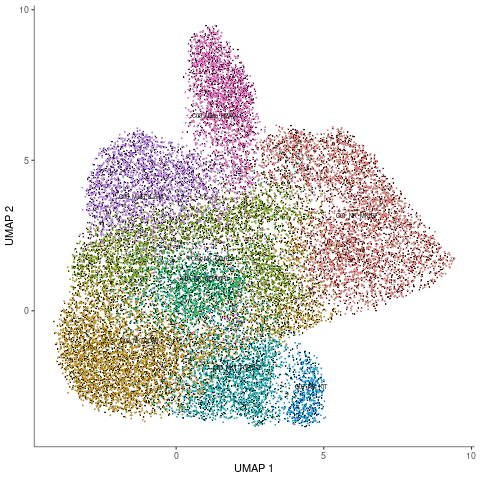

In [ ]:
%%R -i adata_NK_raw
sce <- adata_NK_raw

gene_metadata <- as.data.frame(rownames(sce))
rownames(gene_metadata) <- rownames(sce)
colnames(gene_metadata) <- c("gene_short_name")
gene_metadata

cds <- new_cell_data_set(expression_data = sce@assays@data$X, 
                         cell_metadata = as.data.frame(sce@colData),
                         gene_metadata = gene_metadata)

reducedDim(cds, "UMAP") <- reducedDim(sce, "UMAP")

  |======================================================================| 100%


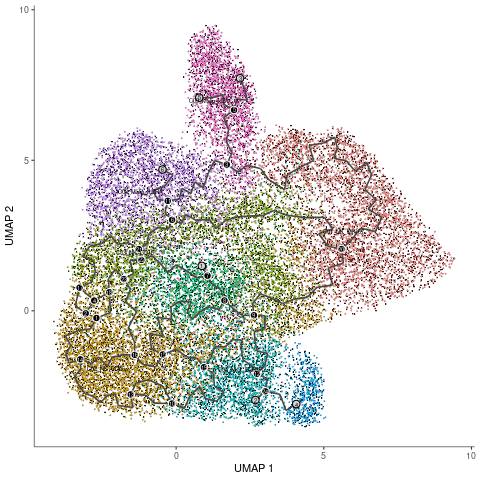

In [110]:
%%R
cds <- cluster_cells(cds)
cds <- learn_graph(cds)
plot_cells(cds, color_cells_by="anno.NK")

In [129]:
%%R
pdf("NKTCL-figure-2.18/NK-monocle3-anno.pdf", width = 8, height = 6)

# 绘制图形
p <- plot_cells(cds, 
                color_cells_by = "anno.NK", 
                reduction_method = "UMAP",
                label_principal_points = TRUE)
print(p)

# 关闭 PDF 设备
dev.off()

png 
  2 


In [131]:
%%R
pdf("NKTCL-figure-2.18/NK-monocle3-pseudotime.pdf", width = 8, height = 6)
cds <- order_cells(cds, root_pr_nodes = "Y_185")
p <- plot_cells(
  cds,
  color_cells_by = "pseudotime",
  label_groups_by_cluster = FALSE,
  label_leaves = FALSE,
  label_branch_points = FALSE,
  graph_label_size = 3
)
print(p)
dev.off()

png 
  2 


Cells aren't colored in a way that allows them to be grouped.


In [143]:
%%R
sig_gene_ids[1:min(100, length(sig_gene_ids))]

  [1] "HLA-DPA1"        "HSPA1A"          "BORCS8"          "KRT24"          
  [5] "CD300C"          "DHX33-DT"        "HBA2"            "CD74"           
  [9] "KIT"             "ENSG00000274767" "S1PR5"           "FCGR3A"         
 [13] "LINC01728"       "LINC01033"       "TSC22D3"         "ENSG00000286550"
 [17] "TTN"             "ENSG00000288096" "HSPA6"           "EFHB"           
 [21] "PHLDA1-AS1"      "RCOR2"           "FCGR2C"          "ENSG00000290581"
 [25] "TSIX"            "BACH2"           "CCL3-AS1"        "MSN"            
 [29] "BTG1-DT"         "VCAM1"           "TCF7"            "BHLHE40"        
 [33] "DNAJB1"          "IFNG"            "LINC02934"       "TALAM1"         
 [37] "GBP4"            "CDKN2B-AS1"      "GBP2"            "CXCL13"         
 [41] "HIF1A"           "VIM-AS1"         "TAMALIN"         "ENSG00000274021"
 [45] "KIR2DL3"         "IRF4"            "LINC02076"       "DNAJC17"        
 [49] "NAV2-AS1"        "ENSG00000286369" "NEPRO-AS1"       "FBX

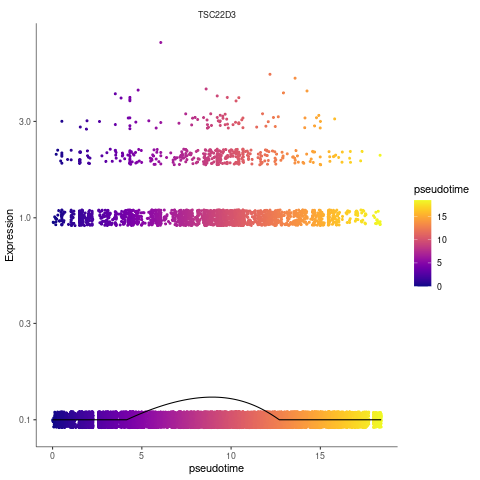

In [157]:
%%R
p_single_gene <- monocle3::plot_genes_in_pseudotime(
  cds["TSC22D3", ],
  color_cells_by = "pseudotime",
  min_expr = 0.1,
)
print(p_single_gene)

In [455]:
adata_T.obs['anno-subTfixed'].cat.categories

Index(['C01_Tn_CCR7', 'C02_Tcm_SELL', 'C03_Tcm_XCL1', 'C04_pTex_IFNG',
       'C05_tTex_TCF7', 'C06_tTex_CD8', 'C07_tTex_CD4', 'C08_Treg_FOXP3',
       'C09_Th_CXCL13', 'C10_Tn/Tcm_IL7R', 'C11_Tctl_GZMK', 'C12_Tprol_MKI67',
       'C13_Malig_MSI2', 'C14_NK/NKT_NCAM1', 'C15_mixed'],
      dtype='object')

In [456]:
adata_subT = adata_T[~adata_T.obs['anno-subTfixed'].isin(['C14_NK/NKT_NCAM1', 'C15_mixed'])]
adata_subT

View of AnnData object with n_obs × n_vars = 50570 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'proliferation', 'anno-subT1', 'anno-focus'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:clone_id_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-T_colors', 'anno-Tfixed_colors', 'a

In [ ]:
%%R -i adata_subT
sce <- adata_subT

# gene_metadata <- as.data.frame(rownames(sce))
# rownames(gene_metadata) <- rownames(sce)
# colnames(gene_metadata) <- c("gene_short_name")
# gene_metadata

# cds <- new_cell_data_set(expression_data = sce@assays@data$X, 
#                          cell_metadata = as.data.frame(sce@colData),
#                          gene_metadata = gene_metadata)

# reducedDim(cds, "UMAP") <- reducedDim(sce, "UMAP")
# cds <- cluster_cells(cds)
# cds <- learn_graph(cds)
# plot_cells(cds, color_cells_by="anno.subTfixed")

In [132]:
%%R
pseudotime_genes <- graph_test(cds, neighbor_graph = "principal_graph", cores = 16)

  |=======================================================| 100%, Elapsed 03:39


In [134]:
%%R
# 按 p 值排序
pseudotime_genes <- pseudotime_genes[order(pseudotime_genes$q_value), ]

# 筛选出显著的基因（例如，q 值小于 0.05）
sig_pseudotime_genes <- pseudotime_genes[pseudotime_genes$q_value < 0.05, ]

# 获取显著基因的 ID
sig_gene_ids <- rownames(sig_pseudotime_genes)

In [ ]:
%%R
p_heatmap <- plot_genes_in_pseudotime(
  cds[sig_gene_ids[1:min(100, length(sig_gene_ids))], ],
  color_cells_by = "pseudotime",
  min_expr = 0.1
)
print(p_heatmap)

In [53]:
%%R -i adata_NK_raw
sce <- adata_NK_raw
# 提取表达矩阵
expr_matrix <- sce@assays@data$X

pdata <- colData(sce)
pdata <- as.data.frame(pdata)
pd <- new("AnnotatedDataFrame", data = pdata)

# 提取基因元数据
fdata <- rowData(sce)
fdata <- as.data.frame(fdata)
fd <- new("AnnotatedDataFrame", data = fdata)

# 创建 CellDataSet 对象
cds <- newCellDataSet(as.matrix(expr_matrix),
                      phenoData = pd,
                      featureData = fd)

# 过滤低质量细胞和基因
cds <- detectGenes(cds, min_expr = 0.1)
expressed_genes <- row.names(subset(fData(cds), num_cells_expressed >= 10))
cds <- cds[expressed_genes, ]

# 归一化数据
cds <- estimateSizeFactors(cds)
cds <- estimateDispersions(cds)


Removing 27 outliers
In addition: There were 26 warnings (use warnings() to see them)


In [55]:
%%R
diff_test_res <- differentialGeneTest(cds,
                                      fullModelFormulaStr = " ~ anno.NK + batch", 
                                      reducedModelFormulaStr = " ~ batch", 
                                      cores = 24)

In addition: There were 24 warnings (use warnings() to see them)


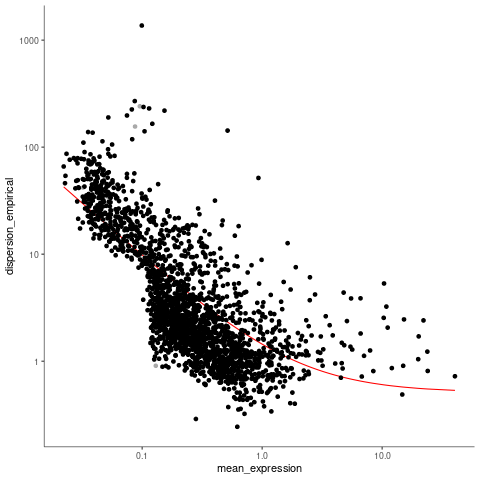

In [57]:
%%R
ordering_genes <- row.names(subset(diff_test_res, qval < 0.01))
cds <- setOrderingFilter(cds, ordering_genes)
plot_ordering_genes(cds)

In [59]:
%%R
?reduceDimension

File: /tmp/RtmppCKXry/Rtxt1bfc59770d18c
reduceDimension            package:monocle             R Documentation



Compute a projection of a CellDataSet object into a lower dimensional

space



Description:



     Monocle aims to learn how cells transition through a biological

     program of gene expression changes in an experiment. Each cell can

     be viewed as a point in a high-dimensional space, where each

     dimension describes the expression of a different gene in the

     genome. Identifying the program of gene expression changes is

     equivalent to learning a _trajectory_ that the cells follow

     through this space. However, the more dimensions there are in the

     analysis, the harder the trajectory is to learn. Fortunately, many

     genes typically co-vary with one another, and so the

     dimensionality of the data can be reduced with a wide variety of

     different algorithms. Monocle provides two different algorithms

     for dimensionality reduction

In [60]:
%%R
cds <- reduceDimension(cds,residualModelFormulaStr = "~batch", reduction_method = "DDRTree")

In [62]:
%%R
?orderCells

File: /tmp/RtmppCKXry/Rtxt1bfc594276d0c6
orderCells               package:monocle               R Documentation



Orders cells according to pseudotime.



Description:



     Learns a "trajectory" describing the biological process the cells

     are going through, and calculates where each cell falls within

     that trajectory. Monocle learns trajectories in two steps. The

     first step is reducing the dimensionality of the data with

     ‘reduceDimension()’. The second is this function. function. This

     function takes as input a CellDataSet and returns it with two new

     columns: ‘Pseudotime’ and ‘State’, which together encode where

     each cell maps to the trajectory. ‘orderCells()’ optionally takes

     a "root" state, which you can use to specify the start of the

     trajectory. If you don't provide a root state, one is selected

     arbitrarily.



Usage:



     orderCells(cds, root_state = NULL, num_paths = NULL, reverse = NULL)

     

Arguments:



     

In [ ]:
%%R
# 降维
cds <- reduceDimension(cds, max_components = 2, method = 'DDRTree')

# 聚类
cds <- clusterCells(cds, num_clusters = 2)

# 拟时排序
cds <- learnGraph(cds)
cds <- orderCells(cds)

# 可视化拟时轨迹
plot_cell_trajectory(cds, color_by = "Pseudotime")

In [31]:
import pyVIA.core as via
#set parameters for Via 2.0
memory=100 #this is a high memory value and will result in probabilistic pathways that avoid transitioning into unrelated cell populations 
cluster_graph_pruning = 0.15 #level of pruning done on the cluster graph. higher number means less pruning (values can range from 0-3 standard deviations)
edgepruning_clustering_resolution = 0.15  # regulates number of clusters. Higher values means fewer clusters (values can range from 0-3 standard deviations)
random_seed = 1234 
knn = 30  # number of neighbors in the knn graph
knn_sequential = 15  # number of neighbors additionally created between sequentially adjacent time points 
n_pcs = 10 # number of principal components
velo_weight = 0  # 0.7 #weight given to velocity based direction compared to pseudotime based direction
t_diff_step = 1 #edges extending between nodes that are more than 2 time steps apart will be removed (i.e. equal to 3 or more time steps apart)
root = ['C01_NK_MKI67'] #for reproducibility, we set the root here. the group level root assignment must correspond to a label that exists in the True-label parameter (must be passed inside a list). For autodetection based on rna-velocity it can be left as None. A single cell index can also be passed e.g. [256], means the 256th cell will be used as a root. Since we will be using the velocity matrices (see below), Via 2.0 will suggest a list of likely root cell states that the user can decide to choose between. It is helpful to examine the top 5 suggested roots and choose the one that seems most reasonable. Note in the output that Via 2.0's suggestions are almost all in the epibliast or Primitive streak state 
neighboring_terminal_states_threshold = 4
max_visual_outgoing_edges = 10#5 #used in differentiation flow chart plots
time_series = True
parc_numeric_cluster_labels = [i for i in adata_NK.obs['leiden-NK1']]
cluster_celltype_label = [i for i in adata_NK.obs['anno-NK']]
use_velocity = True
velo_weight = 0.5

if use_velocity:
    gene_matrix =np.asmatrix(adata_NK.layers['Ms'])
    velocity_matrix = np.asmatrix(adata_NK.layers['velocity'])
    velo_weight=velo_weight
else: 
    gene_matrix =None
    velocity_matrix = None
    velo_weight=0
vNK = via.VIA(adata_NK.obsm['X_pca_harmony'][:, 0:n_pcs], true_label = cluster_celltype_label,
        edgepruning_clustering_resolution=edgepruning_clustering_resolution,
        edgepruning_clustering_resolution_local=1, knn=knn, memory=memory,
        root_user=root, random_seed=random_seed,
        knn_sequential_reverse=knn_sequential,
        gene_matrix=gene_matrix, velocity_matrix=velocity_matrix,
        velo_weight=velo_weight,
        )

In [32]:
from datetime import datetime
print(f'{datetime.now()}\tRun Via2.0')
vNK.run_VIA()
print(f'{datetime.now()}\tEnd Via2.0 computation')

2025-03-21 11:28:58.449267	Run Via2.0
2025-03-21 11:28:58.449333	Running VIA over input data of 23666 (samples) x 10 (features)
2025-03-21 11:28:58.449344	Knngraph has 30 neighbors
2025-03-21 11:29:05.978108	Finished global pruning of 30-knn graph used for clustering at level of 0.15. Kept 48.8 % of edges. 
2025-03-21 11:29:06.132051	Number of connected components used for clustergraph  is 1
2025-03-21 11:29:08.153751	Commencing community detection
2025-03-21 11:29:10.944762	Finished community detection. Found 88 clusters.
2025-03-21 11:29:10.951872	Merging 66 very small clusters (<10)
2025-03-21 11:29:10.957734	Finished detecting communities. Found 22 communities
2025-03-21 11:29:10.959143	Making cluster graph. Global cluster graph pruning level: 0.15
2025-03-21 11:29:11.071076	Graph has 1 connected components before pruning
2025-03-21 11:29:11.073367	Graph has 1 connected components after pruning
2025-03-21 11:29:11.073541	Graph has 1 connected components after reconnecting
2025-03-2

/home/rzh/BCY/lib/python3.10/site-packages/pyVIA/core.py:176: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  g.set_node_ids(node_ids=None,


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
2025-03-21 11:29:27.152905	Identifying terminal clusters corresponding to unique lineages...
2025-03-21 11:29:27.152925	Closeness:[0, 2, 4, 5, 6, 7, 9, 10, 16, 18]
2025-03-21 11:29:27.152935	Betweenness:[0, 2, 4, 5, 6, 7, 8, 9, 10, 14, 16, 17]
2025-03-21 11:29:27.152941	Out Degree:[0, 1, 2, 4, 5, 6, 7, 9, 10, 12, 16, 18, 19]
2025-03-21 11:29:27.153137	Cluster 2 had 3 or more neighboring terminal states [4, 9, 16] and so we removed cluster 4
2025-03-21 11:29:27.153335	Terminal clusters corresponding to unique lineages in this component are [0, 2, 9, 10, 16, 18] 
2025-03-21 11:29:27.153357	Calculating lineage probability at memory 100


/home/rzh/BCY/lib/python3.10/site-packages/pyVIA/core.py:176: UserWarning: WARNING: Implicitly set node IDs to the canonical node ordering due to missing IDs field in the raw CSR npz file. This warning message can be suppressed by setting implicit_ids to True in the read_npz function call, or by setting the --implicit_ids flag in the CLI
  g.set_node_ids(node_ids=None,


  0%|          | 0/1000 [00:00<?, ?it/s]

2025-03-21 11:29:31.456708	Cluster or terminal cell fate 0 is reached 32.0 times
2025-03-21 11:29:31.495688	Cluster or terminal cell fate 2 is reached 763.0 times
2025-03-21 11:29:31.536731	Cluster or terminal cell fate 9 is reached 492.0 times
2025-03-21 11:29:31.576198	Cluster or terminal cell fate 10 is reached 481.0 times
2025-03-21 11:29:31.614542	Cluster or terminal cell fate 16 is reached 554.0 times
2025-03-21 11:29:31.657138	Cluster or terminal cell fate 18 is reached 87.0 times
2025-03-21 11:29:31.693001	There are (6) terminal clusters corresponding to unique lineages {0: 'C09_Malig_H2AC11', 2: 'C05_NKT_FGFBP2', 9: 'C07_NK_KIT', 10: 'C02_NK_CD56', 16: 'C02_NK_CD56', 18: 'C09_Malig_H2AC11'}
2025-03-21 11:29:31.693076	Begin projection of pseudotime and lineage likelihood
2025-03-21 11:29:32.338070	Transition matrix with weight of 0.5 on RNA velocity
2025-03-21 11:29:32.338609	Cluster graph layout based on forward biasing
2025-03-21 11:29:32.340294	Starting make edgebundle viagr

/home/rzh/BCY/lib/python3.10/site-packages/scipy/sparse/_index.py:100: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_intXint(row, col, x.flat[0])


2025-03-21 14:30:18.460810	Plot Via2.0 cluster graph
tune edges False


/home/rzh/BCY/lib/python3.10/site-packages/pyVIA/plotting_via.py:3702: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  sct = ax.scatter(node_pos[:, 0], node_pos[:, 1],


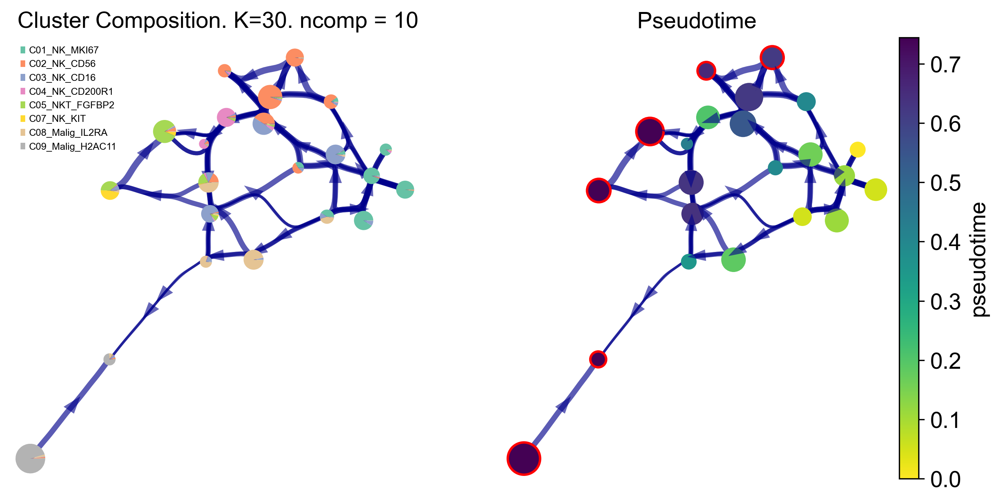

In [71]:
print(f'{datetime.now()}\tPlot Via2.0 cluster graph')

# f, ax, ax1=via.plot_piechart_viagraph(via_object=v0, cmap_piechart='viridis_r', cmap='viridis_r',  reference_labels=cluster_celltype_label, headwidth_arrow=0.4,
#                         highlight_terminal_clusters=True, show_legend=True)
# f.set_size_inches(10, 5)
f, ax, ax1=via.plot_piechart_viagraph(via_object=vNK, headwidth_arrow=0.2, show_legend=True, ax_text=False, pie_size_scale=0.6, cmap_piechart='Set2', 
                        highlight_terminal_clusters=True, size_node_notpiechart=0.8)
f.set_size_inches(10, 5)
f.savefig(f'{figPath}/pyVIA_NK.svg')

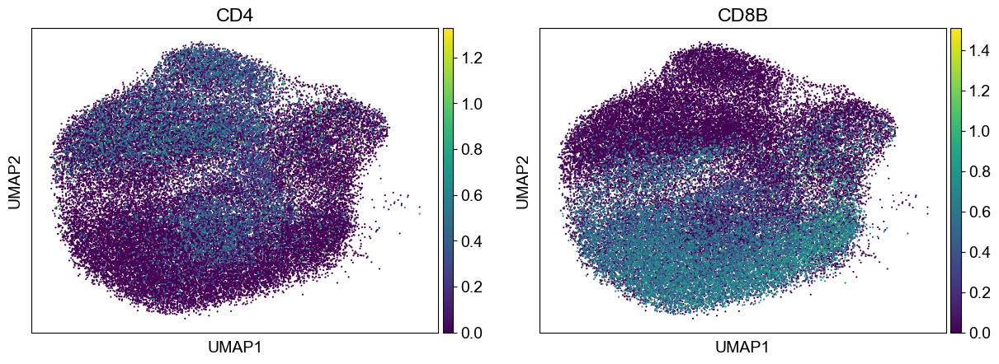

In [460]:
sc.pl.umap(adata_subT, color=['CD4', 'CD8B'], size=10)

Area under curve MKI67 for branch C09_Malig_H2AC11 is 0.10015558681511025
Area under curve MKI67 for branch C05_NKT_FGFBP2 is 0.09640201492392678
Area under curve MKI67 for branch C07_NK_KIT is 0.09539708531341505
Area under curve MKI67 for branch C02_NK_CD56 is 0.09277904044189544
Area under curve MKI67 for branch C02_NK_CD56 is 0.0865756960862567
Area under curve MKI67 for branch C09_Malig_H2AC11 is 0.09730656619914649
Area under curve IL2RA for branch C09_Malig_H2AC11 is 0.008344680477510958
Area under curve IL2RA for branch C05_NKT_FGFBP2 is 0.008876609216115636
Area under curve IL2RA for branch C07_NK_KIT is 0.009359806488755295
Area under curve IL2RA for branch C02_NK_CD56 is 0.006024355053779557
Area under curve IL2RA for branch C02_NK_CD56 is 0.006093544940398226
Area under curve IL2RA for branch C09_Malig_H2AC11 is 0.009075707578171284
Area under curve MSI2 for branch C09_Malig_H2AC11 is 0.003500408191419599
Area under curve MSI2 for branch C05_NKT_FGFBP2 is 0.0041854586320242

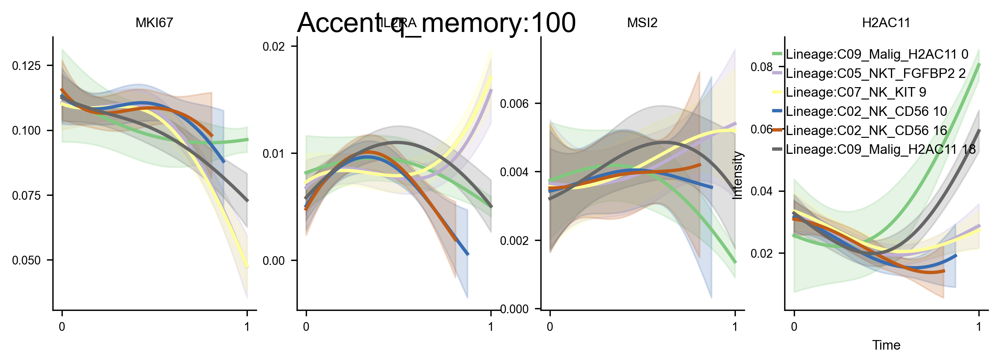

In [40]:
genes=['MKI67','IL2RA','MSI2', 'H2AC11']
df_genes_sc = pd.DataFrame(adata_NK[:, genes].X.todense(), columns=genes)

spline_order = 3
n_splines = 5
fig, axs= via.get_gene_expression(via_object=vNK, gene_exp=df_genes_sc, marker_genes=genes,
                        n_splines=n_splines, spline_order=spline_order, cmap='Accent')
print(memory,'q_memory')
plt.suptitle('Accent q_memory:' + str(memory))
fig.set_size_inches(10, 3)

In [37]:
vNK.embedding = adata_NK.obsm['X_umap']

In [45]:
adata_NK

AnnData object with n_obs × n_vars = 23666 × 33727
    obs: 'anno-NK', 'batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'leiden-NK1'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'anno-NK_colors', 'batch_colors', 'log1p', 'neighbors', 'pca', 'velocity_params'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'matrix', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

In [50]:
print(f'{datetime.now()}\tStart Computing Atlas View')
dict_coarse = {'notochord':2.5, 'central_nervous_system':5.5,'neural_crest':4.5,'paraxial_mesoderm':0,'intermediate_mesoderm':1,'lateral_mesoderm':1.5,
                       'mesenchyme':2.0,'hematopoietic_system':0.5,'periderm':8,'endoderm':7}
decay = 0.55#0.7  # increasing decay increasing merging of edges
i_bw = 0.035#0.05  # increasing bw increases merging of edges
global_visual_pruning = 0.55
n_milestones = 150

hammerbundle_dict = via.make_edgebundle_milestone(via_object=vNK, n_milestones=n_milestones, decay=decay,
                                                  initial_bandwidth=i_bw,
                                                  global_visual_pruning=global_visual_pruning)
vNK.hammerbundle_milestone_dict = hammerbundle_dict

2025-03-21 13:33:11.304091	Start Computing Atlas View
2025-03-21 13:33:11.305003	Start finding milestones
2025-03-21 13:33:14.493678	End milestones with 150
2025-03-21 13:33:14.634315	Recompute weights
2025-03-21 13:33:14.673679	pruning milestone graph based on recomputed weights
2025-03-21 13:33:14.675461	Graph has 1 connected components before pruning
2025-03-21 13:33:14.676293	Graph has 1 connected components after pruning
2025-03-21 13:33:14.676521	Graph has 1 connected components after reconnecting
2025-03-21 13:33:14.678809	regenerate igraph on pruned edges
2025-03-21 13:33:14.705134	Setting numeric label as single cell pseudotime for coloring edges
2025-03-21 13:33:14.763571	Making smooth edges


In [49]:
vNK.embedding

array([[ 1.435,  1.613],
       [ 1.587,  1.68 ],
       [-3.169,  1.515],
       ...,
       [ 2.886, -3.481],
       [ 2.31 , -2.26 ],
       [ 4.575, -2.225]], dtype=float32)

inside add sc embedding second if


/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


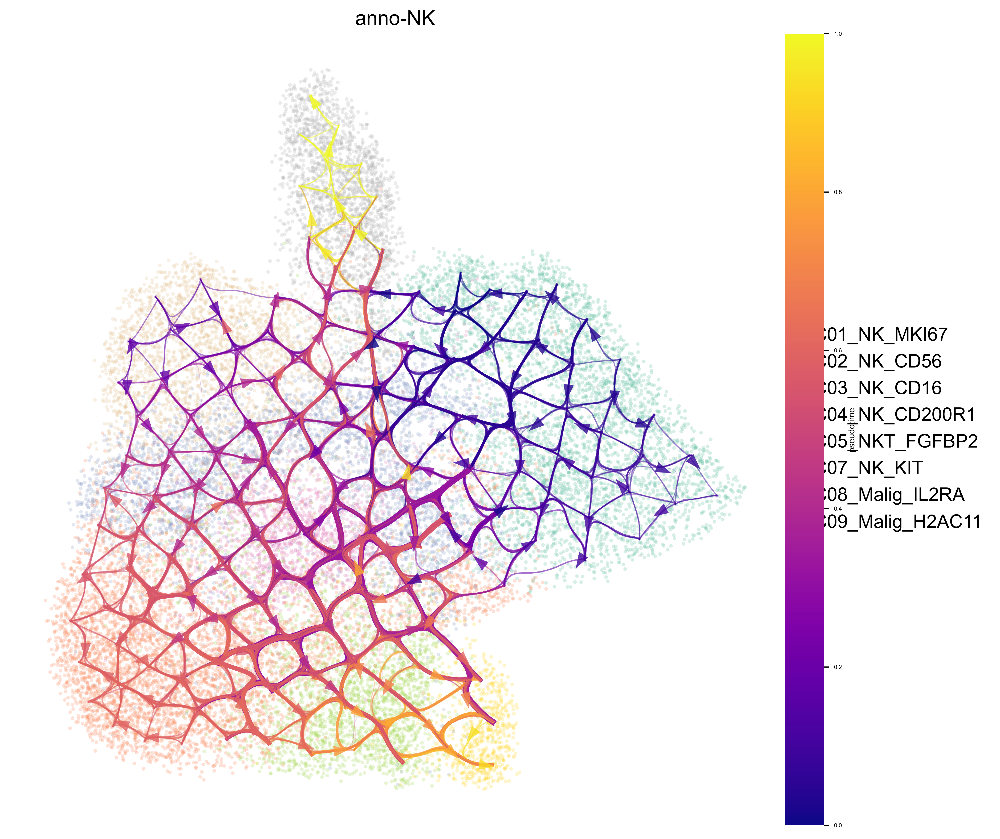

In [65]:
figPath = 'NKTCL-figure-2.18'
headwidth_bundle = 0.2
fig, ax = via.plot_atlas_view(via_object=vNK, sc_labels=parc_numeric_cluster_labels, fontsize_labels=4, text_labels=False,
                              add_sc_embedding=True, sc_scatter_alpha=0.25, sc_scatter_size=5, 
                              cmap='plasma', linewidth_bundle=3, 
                              headwidth_bundle=headwidth_bundle)
fig.set_size_inches(10, 10)
sc.pl.umap(adata_NK, color=['anno-NK'], ax=ax, size=25, palette='Set2', alpha=0.25)
fig.savefig(f"{figPath}/pyVIA-dotedge.png", dpi=400, bbox_inches='tight')

inside add sc embedding second if


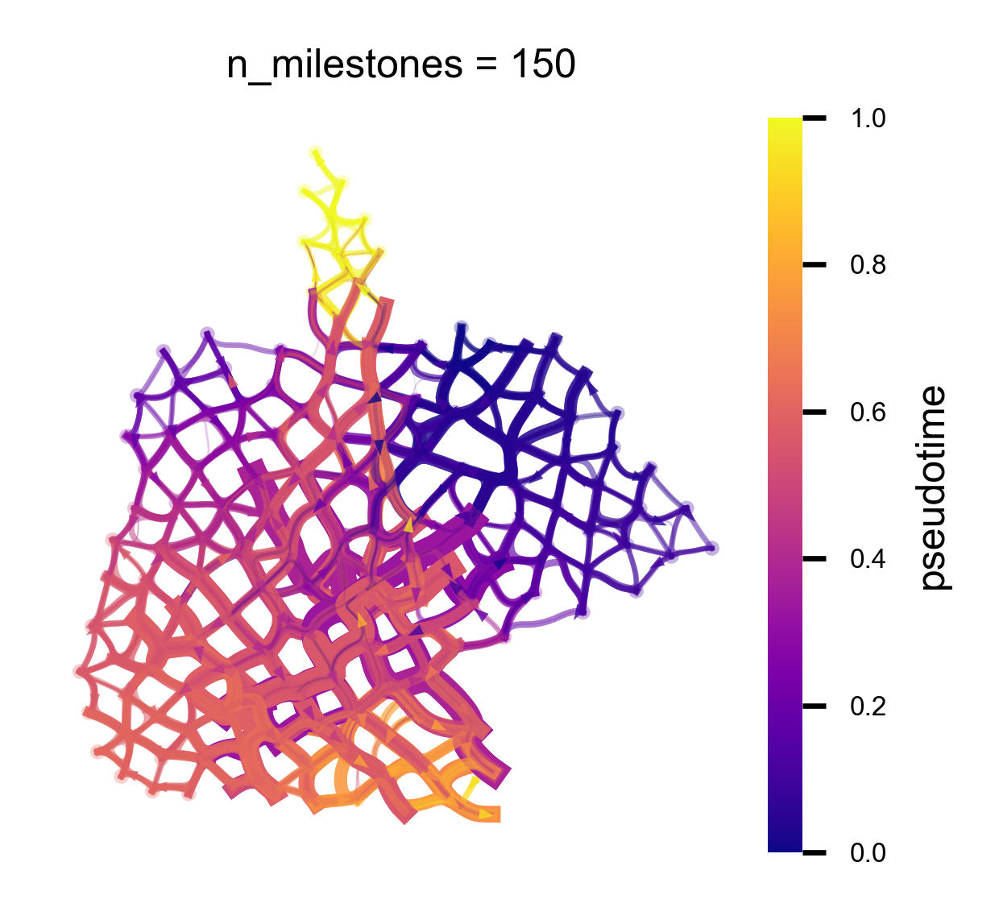

In [68]:
figPath = 'NKTCL-figure-2.18'
headwidth_bundle = 0.2
fig, ax = via.plot_atlas_view(via_object=vNK, sc_labels=parc_numeric_cluster_labels, fontsize_labels=4, text_labels=False,
                              add_sc_embedding=True, sc_scatter_alpha=0.25, sc_scatter_size=5, 
                              cmap='plasma', linewidth_bundle=3, 
                              headwidth_bundle=headwidth_bundle)
fig.set_size_inches(2, 2)
fig.savefig(f"{figPath}/pyVIA-edge.pdf",  bbox_inches='tight')

head df full          pt         celltype
0  0.428915   C04_NK_CD200R1
1  0.567604      C03_NK_CD16
2  0.600950      C02_NK_CD56
3  0.841742   C05_NKT_FGFBP2
4  0.349257  C08_Malig_IL2RA
dict temp Counter({'C01_NK_MKI67': 0.9095840867992767, 'C04_NK_CD200R1': 0.05244122965641953, 'C08_Malig_IL2RA': 0.018083182640144666, 'C03_NK_CD16': 0.009041591320072333, 'C05_NKT_FGFBP2': 0.007233273056057866, 'C09_Malig_H2AC11': 0.0018083182640144665, 'C07_NK_KIT': 0.0018083182640144665})
dict temp Counter({'C01_NK_MKI67': 0.7800539083557951, 'C08_Malig_IL2RA': 0.14339622641509434, 'C03_NK_CD16': 0.05498652291105121, 'C02_NK_CD56': 0.009703504043126684, 'C09_Malig_H2AC11': 0.009703504043126684, 'C04_NK_CD200R1': 0.00215633423180593})
dict temp Counter({'C01_NK_MKI67': 0.8853736817973407, 'C03_NK_CD16': 0.07152682255845942, 'C08_Malig_IL2RA': 0.02521779000458505, 'C04_NK_CD200R1': 0.007794589637780834, 'C02_NK_CD56': 0.005502063273727648, 'C09_Malig_H2AC11': 0.0036680421824850985, 'C07_NK_KIT': 0.000

Exception ignored in: <function SexpCapsule.__del__ at 0x7fcc6358e9e0>
Traceback (most recent call last):
  File "/home/rzh/BCY/lib/python3.10/site-packages/rpy2/rinterface_lib/_rinterface_capi.py", line 143, in __del__
    _release(self._cdata)
  File "/home/rzh/BCY/lib/python3.10/site-packages/rpy2/rinterface_lib/_rinterface_capi.py", line 69, in _release
    def _release(cdata: FFI.CData) -> None:
KeyboardInterrupt: 
Exception ignored in: <function SexpCapsule.__del__ at 0x7fcc6358e9e0>
Traceback (most recent call last):
  File "/home/rzh/BCY/lib/python3.10/site-packages/rpy2/rinterface_lib/_rinterface_capi.py", line 143, in __del__
    _release(self._cdata)
  File "/home/rzh/BCY/lib/python3.10/site-packages/rpy2/rinterface_lib/_rinterface_capi.py", line 74, in _release
    openrlib.rlib.R_ReleaseObject(cdata)
KeyboardInterrupt: 


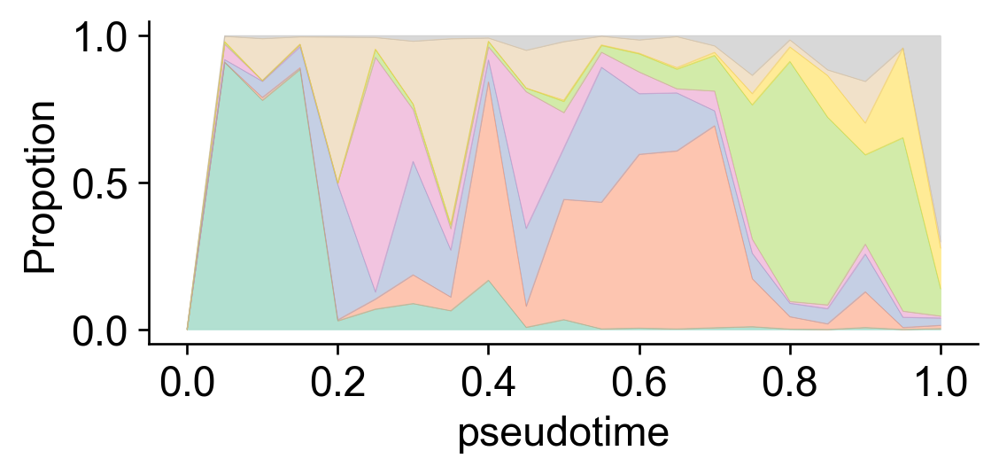

In [160]:
ax = via.plot_population_composition(vNK, xlabel='pseudotime', ylabel='Propotion', legend=False,  title='', cmap='Set2', n_intervals=20)
ax.figure.set_size_inches(5, 2)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.figure.savefig(f'{figPath}/pseudo_prop.svg')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


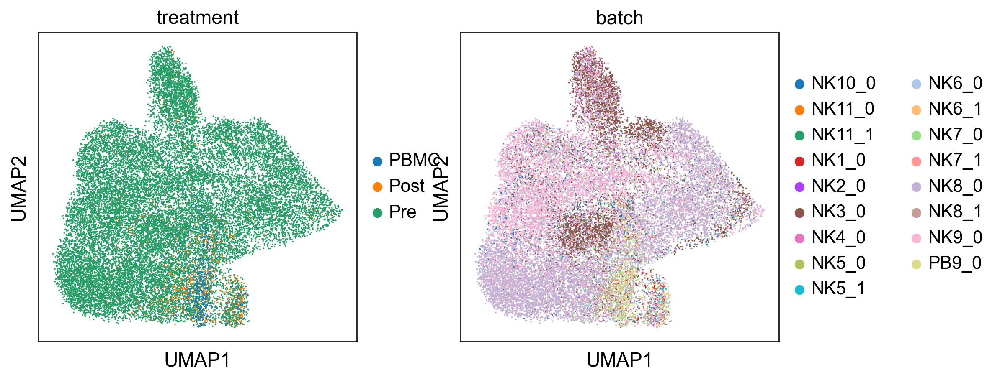

In [166]:
def anno(adata:ad.AnnData, annoDict:dict, obsKey='cnv_status', obsVal='cnv_leiden', default="Unknown"):
  if default is not None:
    adata.obs[obsKey] = default
  for key in annoDict.keys():
    adata.obs.loc[adata.obs[obsVal].isin(annoDict[key]), obsKey] = key
  return adata
annot = {
  'Pre':['NK1_0', 'NK2_0', 'NK3_0', 'NK4_0','NK5_0', 
          'NK6_0','NK7_0',  'NK8_0', 'NK9_0','NK10_0','NK11_0',],  # CD3D
  'Post': ['NK5_1', 'NK6_1','NK7_1', 'NK8_1','NK11_1',],  # NCAM1
  'Recu': ['RR6_0'],
  'PBMC': ['PB9_0'], # MS4A1
}
adata_NK = anno(adata=adata_NK, obsKey='treatment', obsVal='batch', annoDict=annot)
sc.pl.umap(adata_NK, color=['treatment', 'batch'])

In [169]:
adata_NK

AnnData object with n_obs × n_vars = 23666 × 33727
    obs: 'anno-NK', 'batch', 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'leiden-NK1', 'treatment'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'anno-NK_colors', 'batch_colors', 'log1p', 'neighbors', 'pca', 'velocity_params', 'treatment_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'matrix', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

head df full          pt celltype
0  0.428915      Pre
1  0.567604      Pre
2  0.600950      Pre
3  0.841742      Pre
4  0.349257      Pre
dict temp Counter({'Pre': 0.9945750452079566, 'Post': 0.0054249547920434})
dict temp Counter({'Pre': 0.997843665768194, 'Post': 0.00215633423180593})
dict temp Counter({'Pre': 0.9931224209078404, 'Post': 0.006419073819348923, 'PBMC': 0.0004585052728106373})
dict temp Counter({'Pre': 0.9959659345584939, 'Post': 0.0031376064545047063, 'PBMC': 0.0008964589870013447})
dict temp Counter({'Pre': 0.9948630136986302, 'Post': 0.004280821917808219, 'PBMC': 0.0008561643835616438})
dict temp Counter({'Pre': 1.0})
dict temp Counter({'Pre': 0.9941860465116279, 'Post': 0.00436046511627907, 'PBMC': 0.0014534883720930232})
dict temp Counter({'Pre': 0.9903100775193798, 'Post': 0.00872093023255814, 'PBMC': 0.0009689922480620155})
dict temp Counter({'Pre': 0.9851485148514851, 'Post': 0.009900990099009901, 'PBMC': 0.0049504950495049506})
dict temp Counter({'Pre': 0.9686

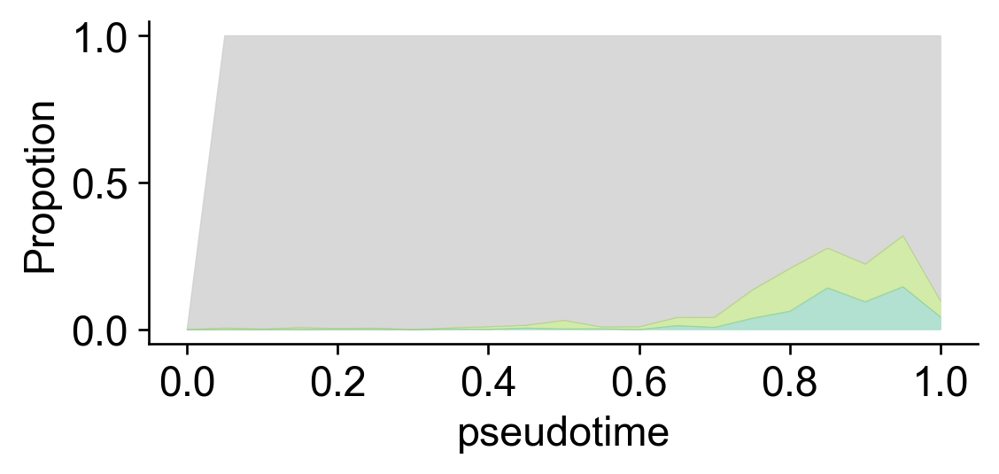

In [170]:
ax = via.plot_population_composition(vNK, celltype_list=list(adata_NK.obs['treatment']),xlabel='pseudotime', ylabel='Propotion', legend=False,  title='', cmap='Set2', n_intervals=20)
ax.figure.set_size_inches(5, 2)
ax.set_title('')
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.figure.savefig(f'{figPath}/pseudo_prop_treat.svg')

In [171]:
adata_CD4T = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-3.18.h5ad")

In [172]:
def clu(adata, key_added="leiden-1", 
        n_neighbors=50, n_pcs=30, 
        rep='X_pca_harmony', 
        do_har=False, 
        max_iter=20, 
        do_scrublet=False, 
        har_key='batch', 
        resolution=1):
    # Computing the neighborhood graph
    if do_scrublet:
        n0 = adata.shape[0]
        print("{0} Cell number: {1}".format(key_added, n0))
        sc.external.pp.scrublet(adata)
        adata = adata[adata.obs['predicted_doublet']==False,:].copy()
        print("{0} Cells retained after scrublet, {1} cells reomved.".format(adata.shape[0], n0-adata.shape[0]))
    else:
        print("Ignoring processing doublet cells...")
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
    sc.pp.pca(adata, svd_solver='arpack', use_highly_variable=True)
    if do_har and len(adata.obs[har_key].cat.categories) > 1:
        sc.external.pp.harmony_integrate(adata, key=har_key,max_iter_harmony=max_iter)
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    else:
        print("Evaluating neighbors only...")
        sc.pp.neighbors(adata, n_neighbors=n_neighbors, n_pcs=n_pcs, use_rep=rep)
    # Run UMAP
    sc.tl.umap(adata)
    sc.tl.leiden(adata, resolution=resolution, key_added=key_added)
    sc.pl.umap(adata, color=key_added, legend_fontoutline=True, palette=sc.pl.palettes.default_20, legend_loc="on data")
    return adata

Ignoring processing doublet cells...


2025-03-27 14:17:38,980 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-03-27 14:17:52,971 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-03-27 14:17:57,434 - harmonypy - INFO - Iteration 1 of 20
2025-03-27 14:18:05,279 - harmonypy - INFO - Iteration 2 of 20
2025-03-27 14:18:11,897 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


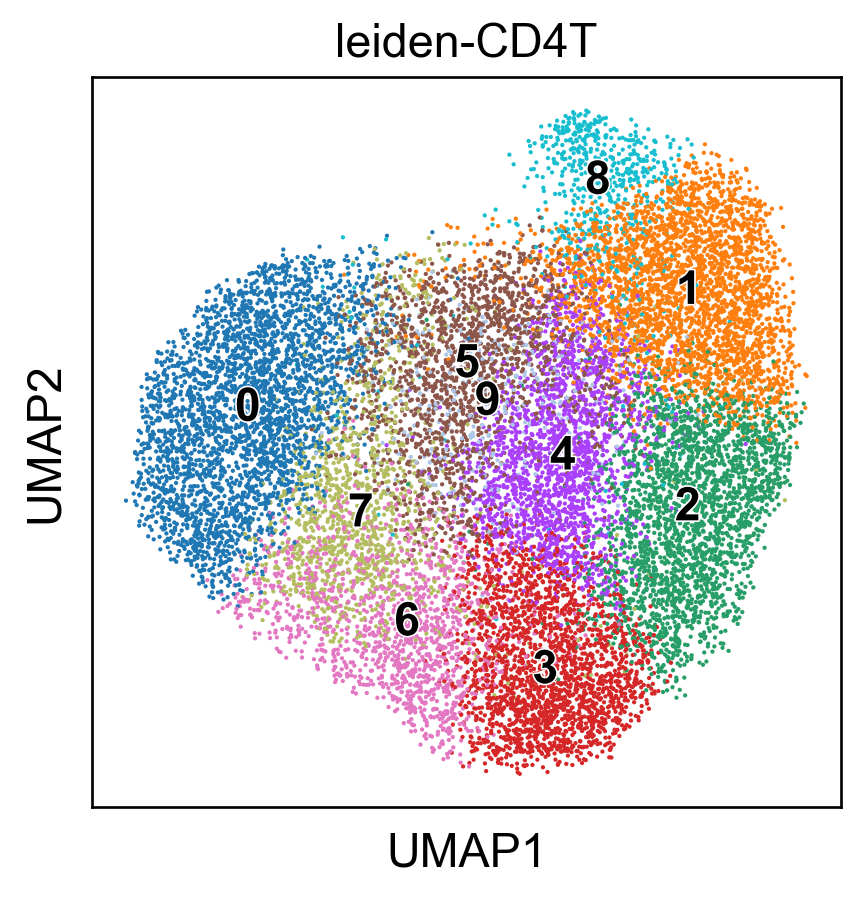

In [173]:
adata_CD4T = clu(adata_CD4T, key_added='leiden-CD4T', do_har=True)

In [175]:
sc.tl.leiden(adata_CD4T, resolution=1.5, key_added='leiden-CD4T1.5')
sc.tl.leiden(adata_CD4T, resolution=1.6, key_added='leiden-CD4T1.6')
sc.tl.leiden(adata_CD4T, resolution=1.7, key_added='leiden-CD4T1.7')
sc.tl.leiden(adata_CD4T, resolution=1.8, key_added='leiden-CD4T1.8')
sc.tl.leiden(adata_CD4T, resolution=2.0, key_added='leiden-CD4T2.0')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


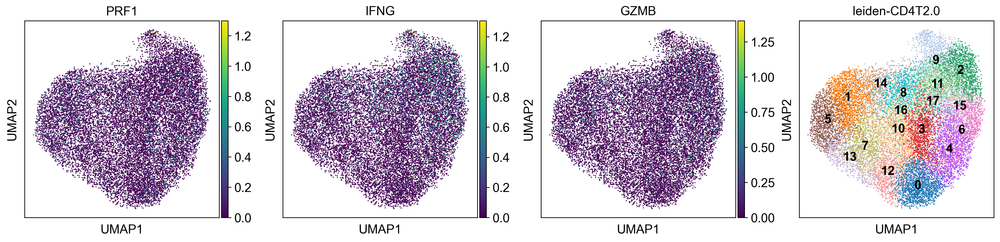

In [323]:
sc.pl.umap(adata_CD4T,color=['PRF1', 'IFNG', 'GZMB', 'leiden-CD4T2.0'], legend_loc='on data')

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


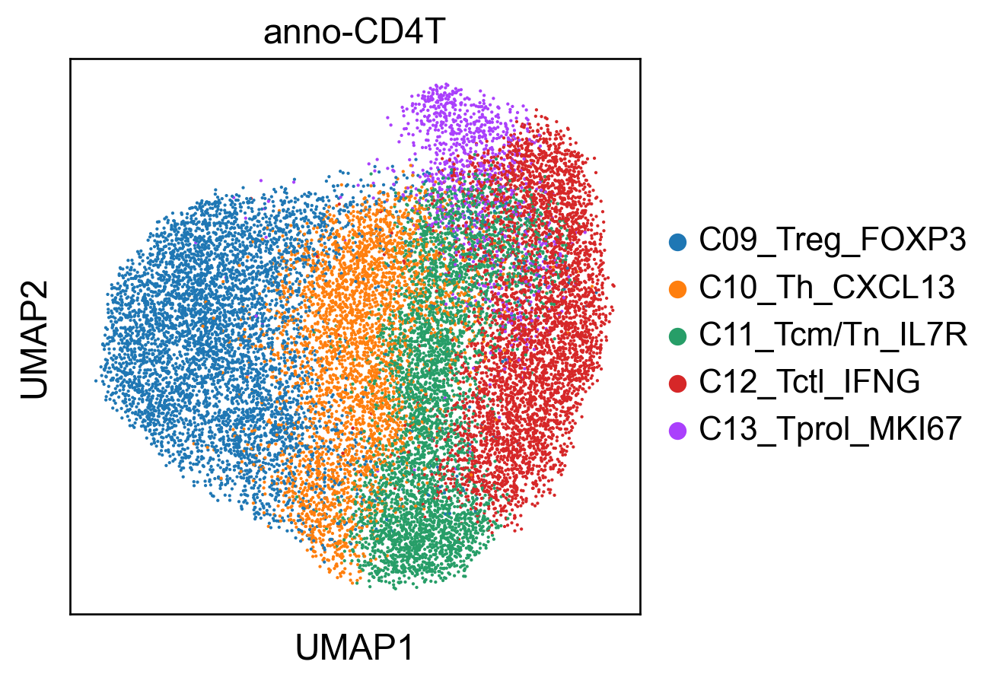

In [325]:
annot = {
  "C09_Treg_FOXP3": ['1', '5', '7', '13', '14'],
  "C10_Th_CXCL13": ['8', '10', '12', '16'],
  "C11_Tcm/Tn_IL7R": ['0', '3', '11', '17'],
  "C12_Tctl_IFNG": ['2', '4', '6', '15'],
  "C13_Tprol_MKI67": ['9'],
}
adata_CD4T = anno(adata_CD4T, annot, 'anno-CD4T', 'leiden-CD4T2.0')
sc.pl.umap(adata_CD4T, color=['anno-CD4T'])

In [326]:
adata_CD4T.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-3.18.h5ad")

In [370]:
adata_CD8T1 = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.4.h5ad")
adata_CD4T1 = sc.read_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD4T-4.4.h5ad")

Ignoring processing doublet cells...


2025-04-04 11:03:06,332 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-04-04 11:03:16,438 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-04-04 11:03:16,545 - harmonypy - INFO - Iteration 1 of 20
2025-04-04 11:03:23,154 - harmonypy - INFO - Iteration 2 of 20
2025-04-04 11:03:29,763 - harmonypy - INFO - Converged after 2 iterations
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


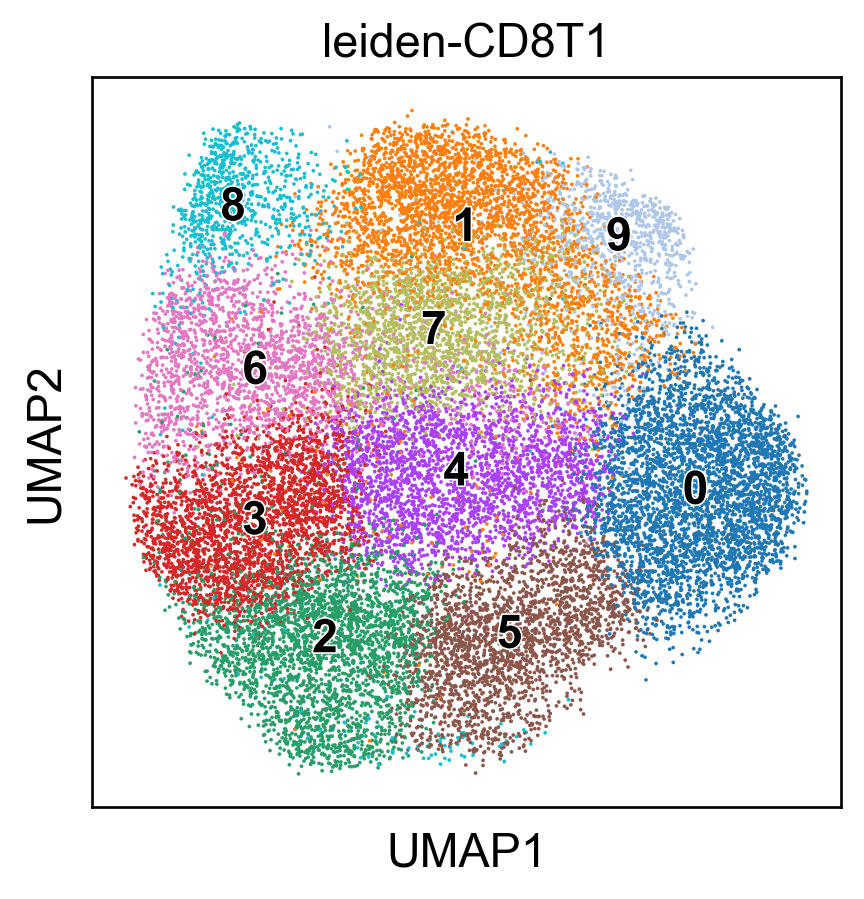

In [371]:
adata_CD8T1 = clu(adata_CD8T1, key_added='leiden-CD8T1', do_har=True)
# adata_CD4T1 = clu(adata_CD4T1, key_added='leiden-CD4T1', do_har=True)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


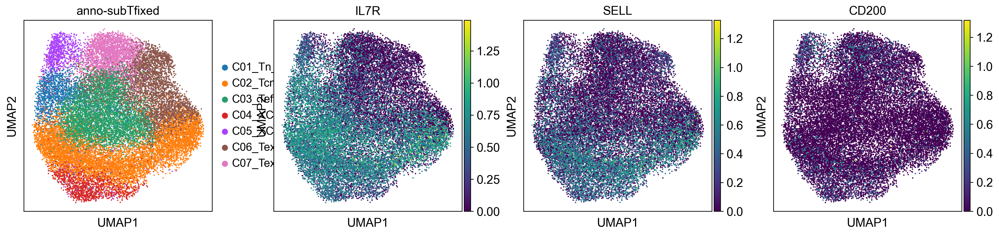

In [372]:
sc.pl.umap(adata_CD8T1, color=['anno-subTfixed', 'IL7R', 'SELL', 'CD200'], size=10)

In [374]:
adata_CD8T1.write_h5ad("/data/NKTCL/NKTCL_Multi/analysis/NKTCL-CD8T-4.4.h5ad")

In [ ]:
import os,sys
import PyComplexHeatmap as pch
print(pch.__version__)
def get_expr(adata, groupby, groups=None, selected_genes=None):
  if groups is None:
    groups = adata.obs[groupby].unique()
  if selected_genes is None:
    selected_genes = adata.var_names
  expr_df = pd.DataFrame(columns=groups)
  for ct in groups:
      adata_cp = adata[:, selected_genes]
      expr = np.array(adata_cp[adata_cp.obs[groupby]==ct].X.mean(axis=0)).flatten()
      expr_df[ct] = expr
  expr_df.index = selected_genes

  frac_df = pd.DataFrame(columns=groups)
  for ct in groups:
      adata_cp = adata[:, selected_genes]
      frac = np.array(np.mean(adata_cp[adata_cp.obs[groupby]==ct].X > 1, axis=0)).flatten()
      frac_df[ct] = frac
  frac_df.index = selected_genes
  return expr_df, frac_df

1.8.1


In [ ]:
selected_genes = [
  'STMN1', 'MKI67', 'TOP2A', 'TUBB', 'MSI2', 'KSR1', 'XIST', 'IL2RA', 'H2AC11','H2AC16',# Malignant
  'PDCD1', 'CTLA4','TIGIT', 'LAG3', 'ENTPD1', 'CXCL13', "NR4A3", "KLRC1", # immune checkpoint
  'PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'GZMH', 'ITGAL', 'GZMM', # cytotoxicity
  "CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18", "IL10", # inf
  "BAG3", "CALU", "DNAJB1", "DUSP1", "EGR1", "FOS", "FOSB", "HIF1A", "HSPA1A", "HSPA1B", "HSPA6", "HSPB1", "HSPH1", "IER2", "JUN", "JUNB", "NFKBIA", "NFKBIZ", "RGS2", "ZFAND2A", "ZFP36", "ZFP36L1", #stress
]

In [ ]:
adata_NK = sc.read_h5ad('/data/NKTCL/NKTCL_Multi/analysis/NKTCL-NK-3.18.h5ad')
adata_NK

AnnData object with n_obs × n_vars = 23666 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'cnv_status', 'cnv_score', 'leiden-T', 'LMP-1', 'leiden-NK', 'leiden-NK1', 'LMP-1.1', 'anno-NK', 'leiden-NK2', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'proliferation', 'inflammatory_score', 'stress_score', 'exhaustion_score', 'cytotoxicity_score', 'EBV'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'anno-NK_colors', 'anno-pca_colors', 'batch_colors', 'cnv_status_colors', 'dendrogram_anno-NK', 'dendrogram_anno-pca', 'dendrogram_leiden-NK1', 'hvg', 'leiden', 'leiden-1_colors', 'leiden-NK1_

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


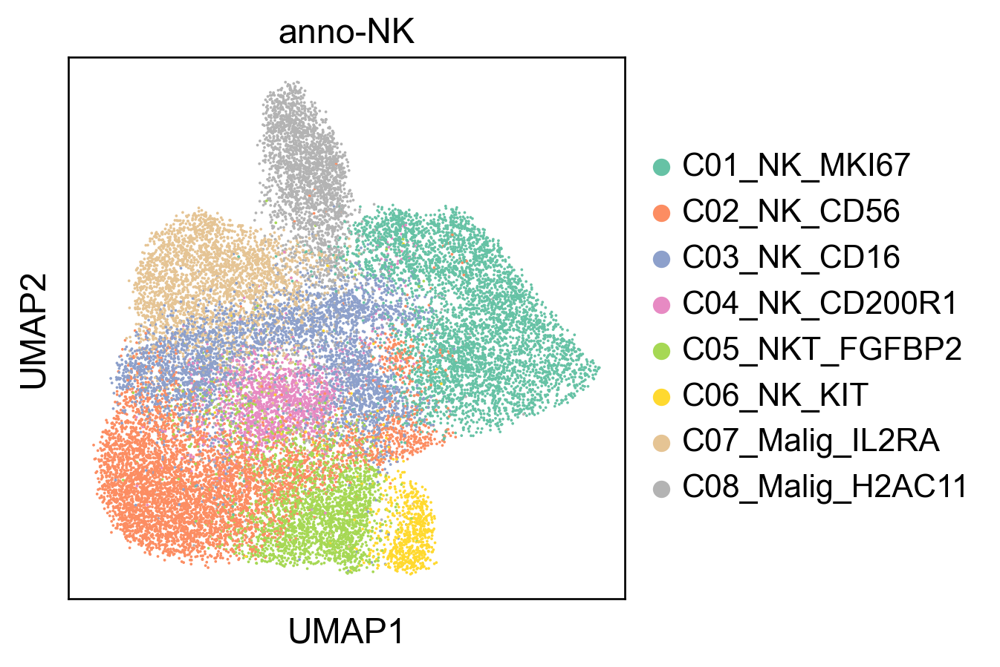

In [ ]:
annot = {
  'C01_NK_MKI67':['C01_NK_MKI67'], # MKI67
  'C02_NK_CD56':['C02_NK_CD56'],  # NCAM1
  'C03_NK_CD16':['C03_NK_CD16'],  # FCGR3A
  'C04_NK_CD200R1': ['C04_NK_CD200R1'], # CD200R1
  'C05_NKT_FGFBP2': ['C05_NKT_FGFBP2'],  # FGFBP2
  'C06_NK_KIT':['C07_NK_KIT'], # KIT
  'C07_Malig_IL2RA': ['C08_Malig_IL2RA'], # IL2RA
  'C08_Malig_H2AC11':['C09_Malig_H2AC11'], # H2AC11
}
adata_NK = anno(adata=adata_NK, obsKey='anno-fixed', obsVal='anno-NK', annoDict=annot)
adata_NK.obs['anno-NK'] = adata_NK.obs['anno-fixed']
sc.pl.umap(adata_NK, color=['anno-NK'], use_raw=False)

In [ ]:
sc.pl.umap(adata_NK, color=['CXCL9'], use_raw=False)

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


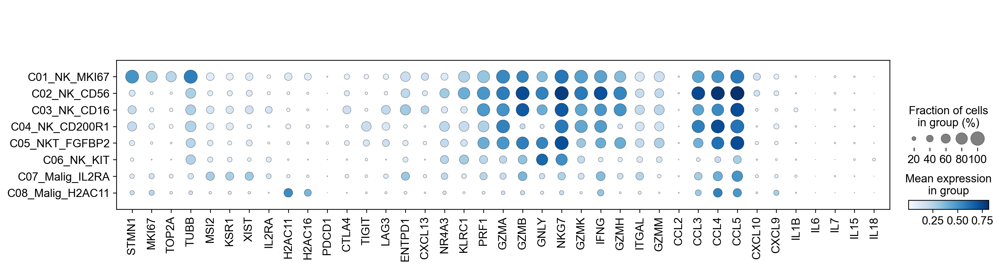

In [ ]:
sc.pl.dotplot(adata_NK, var_names=selected_genes, groupby='anno-NK', cmap='Blues', use_raw=False)

In [354]:
inhibit_genes = pd.DataFrame(["KIR2DL1", "KIR3DL1", "SIGLEC9", "CD300A", "SIGLEC7", "KLRB1", "KLRG1", "CD96", "KLRD1", "KLRC1", ], columns=['Gene'])
inhibit_genes['anno'] = 'Inhibitor'
MHCI_genes = pd.DataFrame(['HLA-E', 'HLA-C', 'HLA-F', 'HLA-B', 'HLA-A'], columns=['Gene'])
MHCI_genes['anno'] = 'MHC class I'
MHCII_genes = pd.DataFrame(['HLA-DQB1', 'HLA-DRA', 'HLA-DQA2', 'HLA-DPB1', 'HLA-DQA1', 'HLA-DPA1', 'HLA-DRB1', 'HLA-DRB5'], columns=['Gene'])
MHCII_genes['anno'] = 'MHC class II'
chemo_genes = pd.DataFrame(['CCR4', 'CXCR6', 'CXCL13', 'CXCR3', 'CCR5', 'CXCR4', 'CCL5', 'CCL3L3', 'CCL4L2', 'CCL3', 'CCL4', 'CXCR2', 'CX3CR1'], columns=['Gene'])
chemo_genes['anno'] = 'Chemokines'
cyto_genes = pd.DataFrame([ 'GNLY', 'PRF1', 'GZMA', 'GZMB','NKG7', 'GZMK', 'IFNG', 'ITGAL', 'GZMH', 'GZMM'], columns=['Gene'])
cyto_genes['anno'] = 'Cytotoxicity'
stress_genes = pd.DataFrame(['FOS', 'NFKBIA', 'NFKBIZ', 'JUN', 'JUNB', 'ZFP36L1', 'DUSP1', 'BAG3', 'DNAJB1', 'HSPA1A', 'HSPA1B', 'HSPB1'], columns=['Gene'])
stress_genes['anno'] = 'Stress'
Malig_genes = pd.DataFrame(["MSI2", 'KSR1', 'XIST', 'ENTPD1', 'TTN', 'IL2RA', 'H2AC11', 'H2AC13', 'H2AC16',], columns=['Gene'])
Malig_genes['anno'] = 'Malignant'
selected_genes = pd.concat([inhibit_genes, cyto_genes, stress_genes]) #  MHCI_genes, MHCII_genes, chemo_genes, Malig_genes, 
selected_genes.index = selected_genes['Gene']

Starting plotting HeatmapAnnotations


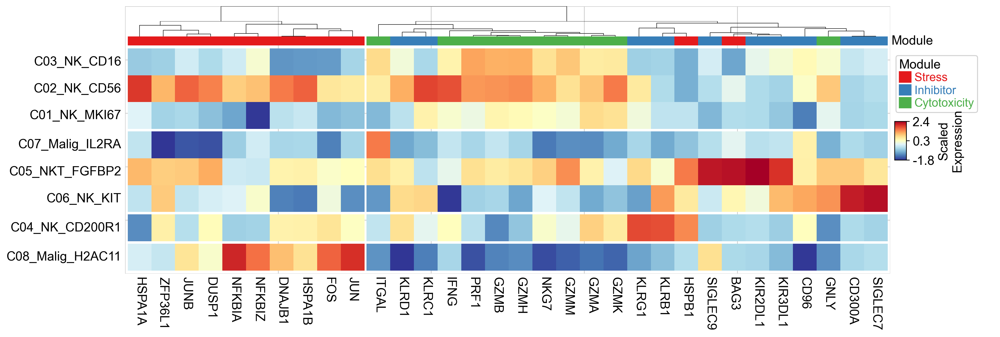

In [355]:
plt.figure(figsize=(15, 4.5))
expr_df, frac_df = get_expr(adata_NK, groupby='anno-NK', selected_genes=selected_genes['Gene'])
# selected_cols = ['STMN1', 'TUBB',  'KSR1', 'XIST', 'IL2RA', 'H2AC11', 'CCL3', 'CXCL13', 'JUN']
# label_cols = expr_df.apply(lambda :x.name if x.name in selected_cols else None,axis=1)
row_ha = pch.HeatmapAnnotation(Module=pch.anno_simple(selected_genes['anno'], cmap='Set1'),
                               legend=True,legend_gap=5,hgap=4, legend_width=2)
# bottom_ha = pch.HeatmapAnnotation(
#                             selected=pch.anno_label(label_cols,colors='black'),
#                             orientation='bottom', verbose=0,
#                             )
cm = pch.ClusterMapPlotter(data=expr_df.T,
                           top_annotation=row_ha,
                    row_cluster=True,
                    col_cluster=True,
                    z_score=1,
                    row_split=4,
                    row_split_gap=0.8,
                    col_dendrogram=True, 
                      row_dendrogram=False,
                      col_split=2,#row_split=2,
                      col_split_gap=0.8,# row_split_gap=0.8,
                      show_rownames=True,
                      show_colnames=True,
                      row_names_side='left',
                      cmap='RdYlBu_r',
                      # xticklabels_kws = {'labelsize': 10, 'size':8},
                      label='Scaled\nExpression', 
                      tree_kws={'row_cmap': 'Set1_r','colors':'black'},verbose=0,legend_gap=5,
                      )
plt.savefig(f"{figPath}/EBV-module-heatmap-inhibit.svg",  bbox_inches='tight')
plt.show()

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:840: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_1681232/444445990.py:3: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=90)


[Text(0, 0, 'C01_NK_MKI67'),
 Text(1, 0, 'C02_NK_CD56'),
 Text(2, 0, 'C03_NK_CD16'),
 Text(3, 0, 'C04_NK_CD200R1'),
 Text(4, 0, 'C05_NKT_FGFBP2'),
 Text(5, 0, 'C06_NK_KIT'),
 Text(6, 0, 'C07_Malig_IL2RA'),
 Text(7, 0, 'C08_Malig_H2AC11')]

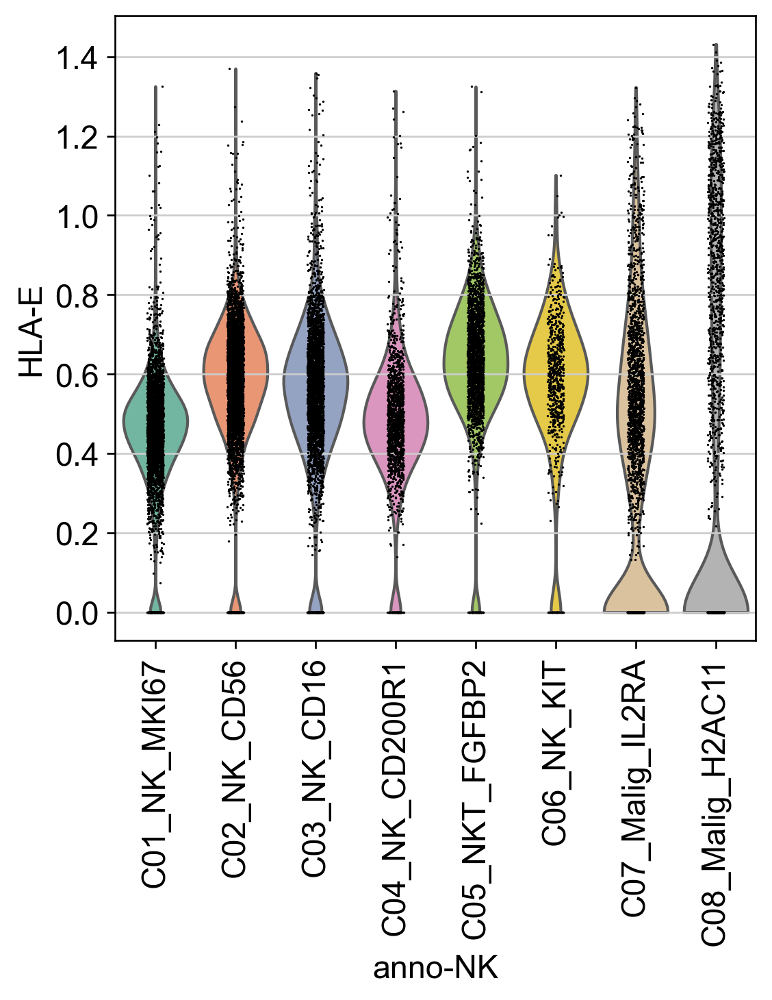

In [ ]:
fig, ax = plt.subplots(figsize=(5, 5))
sc.pl.violin(adata_NK, keys=['HLA-E'], groupby='anno-NK', ax=ax, show=False)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)

In [96]:
import scanpy as sc

from gene_trajectory.add_gene_bin_score import add_gene_bin_score
from gene_trajectory.coarse_grain import select_top_genes, coarse_grain_adata
from gene_trajectory.extract_gene_trajectory import get_gene_embedding, extract_gene_trajectory
from gene_trajectory.get_graph_distance import get_graph_distance
from gene_trajectory.gene_distance_shared import cal_ot_mat
from gene_trajectory.run_dm import run_dm
from gene_trajectory.plot.gene_trajectory_plots import plot_gene_trajectory_3d, plot_gene_trajectory_umap, plot_gene_trajectory_2d
from gene_trajectory.util.download_file import download_file_if_missing

In [276]:
from datetime import datetime

def timeprint(string):
  print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] {string}")

def run_gene_trajectory(adata, add_genes=[]):
  timeprint("Start running gene trajectory...")
  genes = select_top_genes(adata, layer='Raw', n_variable_genes=500)
  timeprint(f"Found {len(genes)} highly variable genes.")
  genes = list(genes)
  genes.extend(add_genes)
  genes = np.unique(genes)
  run_dm(adata)
  timeprint("Running Cell graph...")
  cell_graph_dist = get_graph_distance(adata, k=10)
  gene_expression_updated, graph_dist_updated = coarse_grain_adata(adata, graph_dist=cell_graph_dist, features=genes, n=500)
  timeprint("Evaluating gene distance...")
  gene_dist_mat = cal_ot_mat(gene_expr=gene_expression_updated, 
                           ot_cost=graph_dist_updated, 
                           show_progress_bar=True)
  timeprint("Generating gene distance...")
  gene_embedding, _ = get_gene_embedding(gene_dist_mat, k = 5)
  timeprint("Generating gene_trajectory...")
  gene_trajectory = extract_gene_trajectory(gene_embedding, gene_dist_mat, t_list = [4, 8, 7], gene_names=genes, k=5)
  return gene_trajectory

def refine_gene_trajectory(adata, genes):
  timeprint("Running Cell graph...")
  cell_graph_dist = get_graph_distance(adata, k=10)
  gene_expression_updated, graph_dist_updated = coarse_grain_adata(adata, graph_dist=cell_graph_dist, features=genes, n=500)
  timeprint("Evaluating gene distance...")
  gene_dist_mat = cal_ot_mat(gene_expr=gene_expression_updated, 
                           ot_cost=graph_dist_updated, 
                           show_progress_bar=True)
  timeprint("Generating gene distance...")
  gene_embedding, _ = get_gene_embedding(gene_dist_mat, k = 5)
  timeprint("Generating gene_trajectory...")
  gene_trajectory = extract_gene_trajectory(gene_embedding, gene_dist_mat, t_list = [4, 8, 7], gene_names=genes, k=5)
  return gene_trajectory

In [213]:
datetime.now().strftime("%Y-%m-%d %H:%M:%S")

'2025-04-10 03:37:42'

In [248]:
adata_expand = adata_CD8T[adata_CD8T.obs['spot_size']>=3]
adata_expand

View of AnnData object with n_obs × n_vars = 18730 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'leiden-CD8T1', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clo

In [ ]:
gene_trajectory_expand = run_gene_trajectory(adata_expand, add_genes=['HLA-DQA1', 'SELL','CCR7','PDCD1', 'GZMK', 'ENTPD1', 'TIGIT', 'HAVCR2', 'CD200','TCF7', 'IL7R', 'ZNF683', 'LAG3', 'CTLA4'])

[2025-04-14 06:34:43] Start running gene trajectory...
[2025-04-14 06:34:48] Found 382 highly variable genes.
[2025-04-14 06:39:55] Running Cell graph...
[2025-04-14 06:41:16] Evaluating gene distance...


100%|██████████| 75855/75855 [00:11<00:00, 6535.16it/s] 


[2025-04-14 06:43:11] Generating gene distance...
[2025-04-14 06:43:11] Generating gene_trajectory...


Early stop reached. 0 gene trajectories were retrieved.


In [277]:
genes = list(gene_trajectory_expand.index)
genes.extend(['HLA-DQA1', 'SELL','CCR7', 'ITGAE', 'HAVCR2', 'GZMB'])
genes = np.unique(genes)
gene_trajectory_expand = refine_gene_trajectory(adata_expand, genes)

[2025-04-14 07:25:18] Running Cell graph...
[2025-04-14 07:26:39] Evaluating gene distance...


100%|██████████| 77421/77421 [00:15<00:00, 5008.23it/s] 


[2025-04-14 07:28:34] Generating gene distance...
[2025-04-14 07:28:34] Generating gene_trajectory...


Early stop reached. 0 gene trajectories were retrieved.


In [233]:
gene_trajectory_CD8T = run_gene_trajectory(adata_CD8T)

[2025-04-13 11:32:03] Start running gene trajectory...
[2025-04-13 11:32:30] Found {genes} highly variable genes.
[2025-04-13 11:42:05] Running Cell graph...
[2025-04-13 11:44:42] Evaluating gene distance...


100%|██████████| 72010/72010 [00:16<00:00, 4396.95it/s] 


[2025-04-13 11:46:39] Generating gene distance...
[2025-04-13 11:46:40] Generating gene_trajectory...


Early stop reached. 0 gene trajectories were retrieved.


In [ ]:
gene_trajectory_NK = run_gene_trajectory(adata_NK)

In [98]:
genes = select_top_genes(adata_CD4T, layer='Raw', n_variable_genes=500)

/home/rzh/BCY/lib/python3.10/site-packages/numba/np/ufunc/parallel.py:371: NumbaWarning: The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.
  warnings.warn(problem)


In [ ]:
len(genes)

347

In [ ]:
run_dm(adata_CD4T)
cell_graph_dist = get_graph_distance(adata_CD4T, k=10)

In [ ]:
gene_expression_updated, graph_dist_updated = coarse_grain_adata(adata_CD4T, graph_dist=cell_graph_dist, features=genes, n=500)

In [ ]:
gene_dist_mat = cal_ot_mat(gene_expr=gene_expression_updated, 
                           ot_cost=graph_dist_updated, 
                           show_progress_bar=True)

100%|██████████| 60031/60031 [00:11<00:00, 5419.89it/s] 


In [ ]:
gene_embedding, _ = get_gene_embedding(gene_dist_mat, k = 5)

In [ ]:
gene_trajectory = extract_gene_trajectory(gene_embedding, gene_dist_mat, t_list = [4, 8, 7], gene_names=genes, k=5)

Early stop reached. 0 gene trajectories were retrieved.


In [ ]:
gene_trajectory_CD4.sort_values(by='Pseudoorder-1')[50:100]

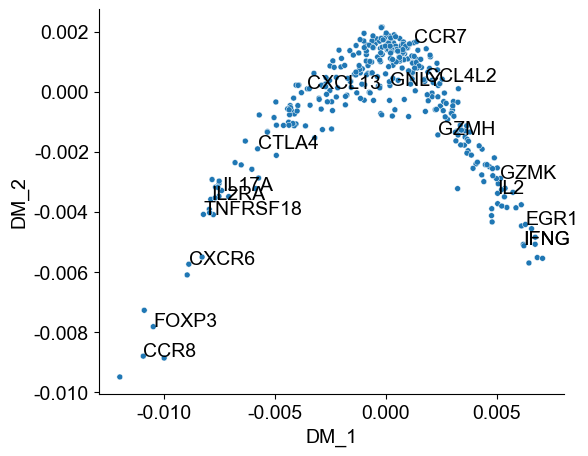

In [332]:
fig, ax = plt.subplots(1, 1, figsize=(6, 5))
plot_gene_trajectory_2d(gene_trajectory_CD4,size=5,label_genes=['CCL4L2','GZMH','IL17A','IFNG','EGR1','IL2','GZMK','CCR7','GNLY','CXCL13','CTLA4','IFNG','IL2RA','TNFRSF18', 'CXCR6',  'FOXP3', 'CCR8'], ax=ax)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.legend_.set_visible(False)
fig.savefig(f'{figPath}/gene_trajectory_CD4.pdf', bbox_inches='tight')

In [ ]:
adata_CD8T

AnnData object with n_obs × n_vars = 24411 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'leiden-CD8T1', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_rank', 'variances', 'variances_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clonal_expa

/home/rzh/BCY/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


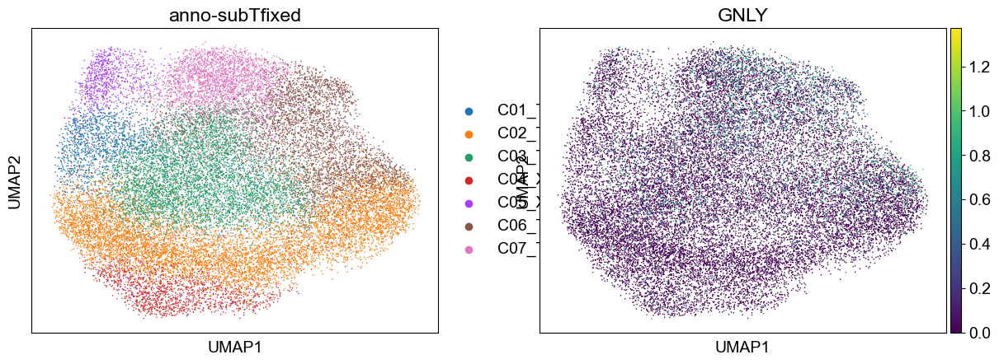

In [ ]:
sc.pl.umap(adata_CD8T, color=['anno-subTfixed', 'GNLY'])

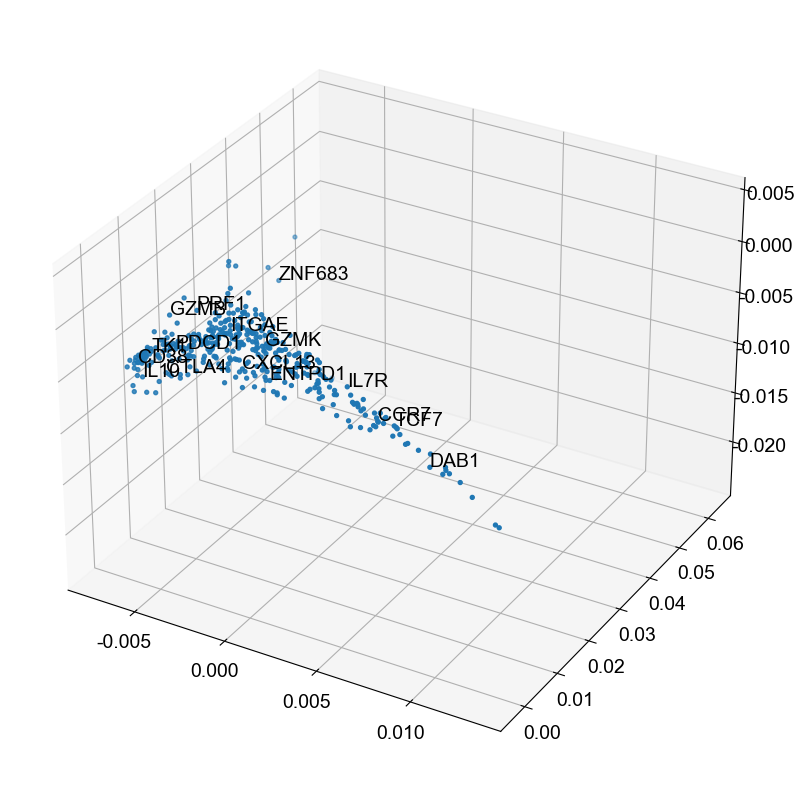

In [292]:
fig = plt.figure(figsize=(10, 10))  # 宽度10英寸，高度8英寸
ax = fig.add_subplot(111, projection='3d')
label_genes=['CD38','IL10','CCR7', 'ITGAE',  'GZMB','TK1','ENTPD1','CTLA4','ZNF683','IL7R','TCF7','PDCD1','DAB1','PRF1', 'GZMK',  'CXCL13',]
gene_trajectory = gene_trajectory_expand
s=8
selections = pd.Categorical(gene_trajectory.selected)

for c in 'DM_1', 'DM_2', 'DM_3', 'selected':
    if c not in gene_trajectory.columns:
        raise ValueError(f'Column {c} is not present in gene trajectory DataFrame')
for c in selections.categories:
    idxs = selections == c
    ax.scatter(xs=gene_trajectory['DM_1'][idxs],
                ys=gene_trajectory['DM_2'][idxs],
                zs=gene_trajectory['DM_3'][idxs],
                s=s,
                label=c)

if label_genes:
    for g in label_genes:
        ax.text(x=gene_trajectory['DM_1'][g],
                y=gene_trajectory['DM_2'][g],
                z=gene_trajectory['DM_3'][g],
                s=g)
fig.savefig(f"{figPath}/gene_trajectory_expand.svg", bbox_inches='tight')

# plot_gene_

In [285]:
gene_trajectory_expand.sort_values(by='Pseudoorder-1').tail(50)

,DM_1,DM_2,DM_3,DM_4,DM_5,selected,Pseudoorder-1
GZMB,-0.004454,0.002201,0.000988,-0.003144,-0.000424,Trajectory-1,345.0
KIF15,-0.004118,-0.000614,-0.000889,-0.001354,0.000550,Trajectory-1,346.0
DIAPH3,-0.004122,-0.000870,-0.001347,-0.001087,0.000422,Trajectory-1,347.0
CCL4L2,-0.004324,0.000196,-0.000020,-0.001923,0.000358,Trajectory-1,348.0
PLK1,-0.004205,-0.000947,-0.001419,-0.001108,0.000436,Trajectory-1,349.0
BUB1,-0.004308,-0.000316,-0.000617,-0.001680,0.000566,Trajectory-1,350.0
KIR2DL4,-0.004262,-0.000648,-0.000933,-0.001317,0.000452,Trajectory-1,351.0
SLC28A3,-0.004390,-0.002442,-0.005082,0.001213,-0.001823,Trajectory-1,352.0
MIR181A1HG,-0.004353,-0.001302,-0.002067,-0.000338,-0.000162,Trajectory-1,353.0
CCL3L3,-0.004448,-0.000227,-0.000715,-0.001651,0.000269,Trajectory-1,354.0


In [449]:
gene_trajectory_NK[gene_trajectory_NK['selected'] == 'Trajectory-1'].sort_values(by=['Pseudoorder-1','Pseudoorder-2'])[100:150]

,DM_1,DM_2,DM_3,DM_4,DM_5,selected,Pseudoorder-1,Pseudoorder-2
XCL2,0.002025,0.000817,-0.006429,-0.000876,0.004438,Trajectory-1,101.0,0.0
ARL4D,-0.000455,0.008236,0.000595,0.010775,0.001649,Trajectory-1,102.0,0.0
AURKA,-0.000054,0.008039,0.001772,-0.005820,0.001366,Trajectory-1,103.0,0.0
IGLV3-1,-0.000063,0.001443,-0.002435,0.001554,-0.005274,Trajectory-1,104.0,0.0
ENSG00000286423,0.000979,-0.003243,0.003451,0.001130,-0.005073,Trajectory-1,105.0,0.0
UBE2C,-0.001047,0.016342,0.005502,-0.015828,0.003631,Trajectory-1,106.0,0.0
KAZN,-0.000107,0.000694,0.000607,0.001360,-0.005352,Trajectory-1,107.0,0.0
CENPE,-0.000278,0.006627,0.002357,-0.004493,-0.000435,Trajectory-1,108.0,0.0
CTNNA3,0.000808,-0.002114,0.002582,0.000915,-0.004405,Trajectory-1,109.0,0.0
HFM1,0.000056,0.003136,0.004446,0.006542,-0.001115,Trajectory-1,110.0,0.0


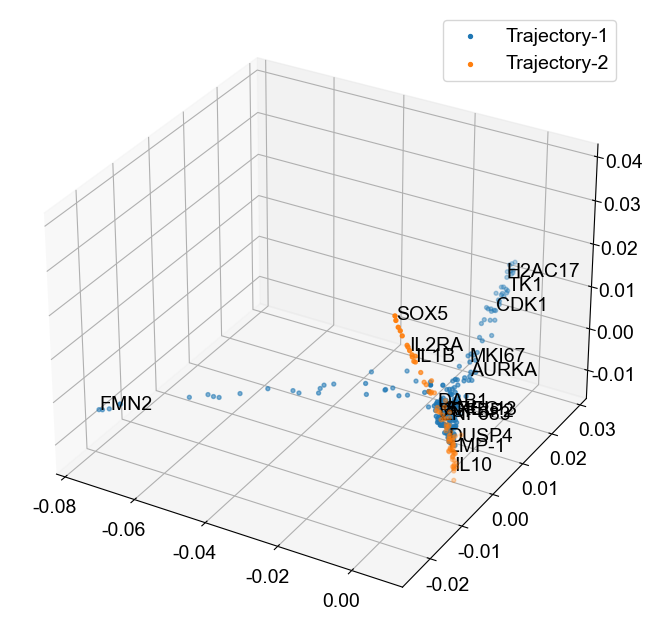

In [453]:
fig = plt.figure(figsize=(8, 8))  # 宽度10英寸，高度8英寸
ax = fig.add_subplot(111, projection='3d')
label_genes=['FMN2', 'IL2RA', 'LMP-1', 'MKI67', 'CXCL13'
             , 'SOX5', 'H2AC17', 'CDK1',  'IL10', 'DUSP4', 'ZNF683', 'IL1B',
             'AREG', 'FGFBP2', 'AURKA', 'TK1', 'DAB1']
gene_trajectory = gene_trajectory_NK
s=8
selections = pd.Categorical(gene_trajectory.selected)

for c in 'DM_1', 'DM_2', 'DM_3', 'selected':
    if c not in gene_trajectory.columns:
        raise ValueError(f'Column {c} is not present in gene trajectory DataFrame')
for c in selections.categories:
    idxs = selections == c
    ax.scatter(xs=gene_trajectory['DM_1'][idxs],
                ys=gene_trajectory['DM_2'][idxs],
                zs=gene_trajectory['DM_3'][idxs],
                s=s,
                label=c)

if label_genes:
    for g in label_genes:
        ax.text(x=gene_trajectory['DM_1'][g],
                y=gene_trajectory['DM_2'][g],
                z=gene_trajectory['DM_3'][g],
                s=g)
ax.legend()
fig.savefig(f"{figPath}/gene_trajectory_NK.svg", bbox_inches='tight')
# plot_gene_trajectory_3d(gene_trajectory_NK, s=3, ax=ax,
#                         label_genes=['FMN2', 'IL2RA', 'LMP-1',
#                                       'MKI67', 'CXCL13', 'SOX5', 'H2AC17', 'CDK1',  'IL10'])
# # 'CD200R1', 'PDLIM1', 'S100B', 'FMN2', 'IL2RA', 'LMP-1', 'CST3', 'TOP2A','TK1', 'XCL1', 'MKI67', 'CXCL13', 'SOX5', 

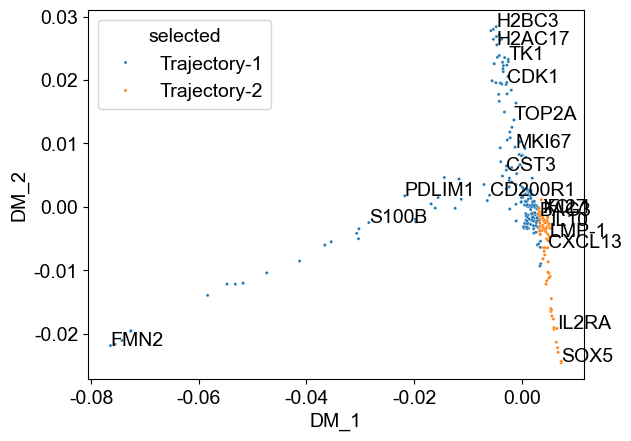

In [188]:
plot_gene_trajectory_2d(gene_trajectory_NK, s=5,
                        label_genes=[ 'CD200R1', 'PDLIM1', 'S100B', 'FMN2', 'IL2RA', 'LMP-1', 'CST3', 'TOP2A', 'BAG3',
                                     'TK1', 'XCL1', 'MKI67', 'CXCL13', 'SOX5', 'H2AC17', 'CDK1', 'H2BC3', 'IL10', 'IFI27'])

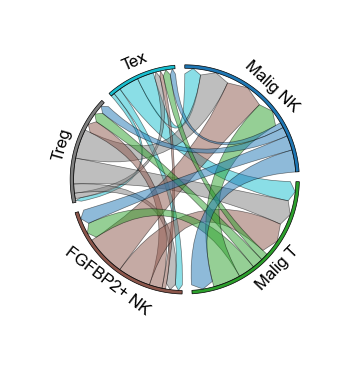

In [476]:
import numpy as np
from pycirclize import Circos
from pycirclize.parser import Matrix

# 定义细胞类型和它们的颜色
cell_types = ["Malig NK", "Malig T", "FGFBP2+ NK", "Treg", "Tex"]
cell_colors = [
    "#3182bd",  # 深蓝色 - Malig NK
    "#6baed6",  # 浅蓝色 - Malig T
    "#e6550d",  # 橙色   - FGFBP2+ NK
    "#fd8d3c",  # 浅橙色 - Treg
    "#31a354",  # 绿色   - Tex
]

# 创建交互矩阵（行表示发送细胞，列表示接收细胞）
matrix = np.array([
    [0, 12, 8, 5, 3],     # Malig NK
    [15, 0, 9, 6, 4],     # Malig T
    [22, 18, 0, 7, 2],    # FGFBP2+ NK
    [16, 14, 5, 0, 3],    # Treg
    [9, 11, 4, 2, 0]      # Tex
])
matrix_df = pd.DataFrame(matrix, index=cell_types, columns=cell_types)

# 创建 Circos 对象
circos = Circos.initialize_from_matrix(
    matrix_df,
    space=5,
    cmap="tab10",
    label_kws=dict(size=12),
    link_kws=dict(ec="black", lw=0.5, direction=1),
)

# 配置每个扇区（细胞类型）
# for i, sector in enumerate(circos.sectors):
#     sector.text(cell_types[i], size=12, color="black", position=50, orientation="horizontal")
#     sector.rect(0, 1, facecolor=cell_colors[i], alpha=0.9)

# # 添加连接（弦）
# for i, source in enumerate(cell_types):
#     for j, target in enumerate(cell_types):
#         if i != j and matrix[i, j] > 0:
#             # 连接强度决定透明度
#             alpha = min(1.0, matrix[i, j] / np.max(matrix) * 1.2)
#             circos.link(source, (0, 1), target, (0, 1), color=cell_colors[i], alpha=alpha, ec="none")


# # 保存图像
# plt.savefig("immune_cell_interaction.svg", format="svg", bbox_inches="tight")
# plt.savefig("immune_cell_interaction.png", dpi=300, bbox_inches="tight")
fig = circos.plotfig(figsize=(3, 3))
# 显示图像
fig.savefig(f"{figPath}/example02.svg")   

In [478]:
adata_T

AnnData object with n_obs × n_vars = 59153 × 33727
    obs: 'batch', 'mt_frac', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_genes', 'n_counts', 'leiden-1', 'leiden-pca', 'anno-pca', 'treatment', 'leiden-T', 'annotation', 'cnv_status', 'cnv_score', 'exhaustion', 'cytotoxicity', 'anno-T', 'clonal_size', 'spot_size', 'CytoTRACE2_Score', 'CytoTRACE2_Potency', 'CytoTRACE2_Relative', 'preKNN_CytoTRACE2_Score', 'preKNN_CytoTRACE2_Potency', 'anno-subT', 'anno-Tfixed', 'anno-subTfixed', 'proliferation', 'anno-subT1', 'anno-focus'
    var: 'ID', 'name', 'type', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'airr:chain_pairing_colors', 'airr:clonal_expansion_colors', 'airr:clone_id_colors', 'airr:receptor_subtype_colors', 'airr:receptor_type_colors', 'anno-T_colors', 'anno-Tfixed_colors', 'anno-pca_

In [486]:
cytogenes = ['PRF1', 'GZMA', 'GZMB', 'GNLY', 'NKG7', 'GZMK', 'IFNG', 'TNFAIP3', 'IL2RA', 'GZMH', 'ITGAL', 'ITGB2']
exgenes = ['PDCD1', 'HAVCR2', 'TIGIT', 'CTLA4', 'LAG3', 'ENTPD1', 'CD200', 'TOX']
infgenes = ["CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18"]
stressgenes = ["BAG3", "CALU", "DNAJB1", "DUSP1", "EGR1", "FOS", "FOSB", "HIF1A", "HSP90AA1", "HSP90AB1", "HSP90B1", "HSPA1A", "HSPA1B", "HSPA6", "HSPB1", "HSPH1", "IER2", "JUN", "JUNB", "NFKBIA", "NFKBIZ", "RGS2", "SLC2A3", "SOCS3", "UBC", "ZFAND2A", "ZFP36", "ZFP36L1"]
# sc.tl.score_genes(adata_T, gene_list=cytogenes, score_name='cytotoxicity', use_raw=False)
sc.tl.score_genes(adata_T, gene_list=exgenes, score_name='exhaustion', use_raw=False)
sc.tl.score_genes(adata_T, gene_list=infgenes, score_name='inflammation', use_raw=False)
sc.tl.score_genes(adata_T, gene_list=stressgenes, score_name='stress', use_raw=False)
# sc.tl.score_genes(adata_NK, gene_list=cytogenes, score_name='cytotoxicity', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=exgenes, score_name='exhaustion', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=infgenes, score_name='inflammation', use_raw=False)
sc.tl.score_genes(adata_NK, gene_list=stressgenes, score_name='stress', use_raw=False)

In [503]:
Tdf_T = adata_T.obs[['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'anno-subTfixed', 'treatment']]
Tdf_T.columns = ['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'annotation', 'treatment']
Tdf_NK = adata_NK.obs[['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'anno-NK', 'treatment']]
Tdf_NK.columns = ['cytotoxicity', 'exhaustion', 'inflammation', 'stress', 'annotation', 'treatment']
Tdf = pd.concat([Tdf_T, Tdf_NK], axis=0)
annot = {
  'NK1_MKI67': ['C01_NK_MKI67'],
  'NK2_CD56': ['C02_NK_CD56'],
  'NK3_CD16': ['C03_NK_CD16'],
  'NK4_CD200R1': ['C04_NK_CD200R1'],
  'NK5_FGFBP2': ['C05_NKT_FGFBP2'],
  'NK6_KIT': ['C06_NK_KIT'],
  'NK7_Malig_IL2RA': ['C07_Malig_IL2RA'],
  'NK8_Malig_H2AC11': ['C08_Malig_H2AC11'],
  'T01_Tn_CCR7': ['C01_Tn_CCR7'],
  'T02_Tcm_SELL': ['C02_Tcm_SELL'],
  'T03_Tcm_XCL1': ['C03_Tcm_XCL1'],
  'T04_pTex_IFNG': ['C04_pTex_IFNG'],
  'T05_tTex_TCF7': ['C05_tTex_TCF7'],
  'T06_tTex_CD8': ['C06_tTex_CD8'],
  'T07_tTex_CD4': ['C07_tTex_CD4'],
  'T08_Treg_FOXP3': ['C08_Treg_FOXP3'],
  'T09_Th_CXCL13': ['C09_Th_CXCL13'],
  'T10_Tn/Tcm_IL7R': ['C10_Tn/Tcm_IL7R'],
  'T11_Tctl_GZMK': ['C11_Tctl_GZMK'],
  'T12_Tprol_MKI67': ['C12_Tprol_MKI67'],
  'T13_Malig_MSI2': ['C13_Malig_MSI2']
}
for key in annot.keys():
  Tdf.loc[Tdf['annotation'].isin(annot[key]), 'cptype'] = key
Tdf = Tdf[Tdf['cptype'].isin(['T04_pTex_IFNG', 'T05_tTex_TCF7', 'T06_tTex_CD8', 
                              'T07_tTex_CD4', 'T08_Treg_FOXP3', 'NK5_FGFBP2', 
                              'NK7_Malig_IL2RA', 'NK8_Malig_H2AC11', 
                              'T12_Tprol_MKI67', 'T13_Malig_MSI2'])]
Tdf = Tdf[Tdf['treatment'].isin(['Pre', 'Post'])]
Tdf

,cytotoxicity,exhaustion,inflammation,stress,annotation,treatment,cptype
AAACCTGCACATCCAA-1-NK10_0,0.054607,-0.011567,0.086435,0.207742,C13_Malig_MSI2,Pre,T13_Malig_MSI2
AAACCTGCACCGAAAG-1-NK10_0,0.124636,-0.035106,0.083573,0.194616,C04_pTex_IFNG,Pre,T04_pTex_IFNG
AAACCTGCAGATCGGA-1-NK10_0,0.263743,-0.080008,0.116108,0.352675,C04_pTex_IFNG,Pre,T04_pTex_IFNG
AAACCTGGTGTTTGTG-1-NK10_0,0.217694,0.069903,0.051302,0.237407,C06_tTex_CD8,Pre,T06_tTex_CD8
AAACGGGAGCTGATAA-1-NK10_0,0.050017,0.207456,0.068237,0.316429,C08_Treg_FOXP3,Pre,T08_Treg_FOXP3
...,...,...,...,...,...,...,...
TTTGGTTTCCAAACAC-1-NK9_0,0.227405,0.221893,0.168604,0.029787,C07_Malig_IL2RA,Pre,NK7_Malig_IL2RA
TTTGGTTTCGGACAAG-1-NK9_0,-0.025620,0.094968,-0.009167,0.078841,C07_Malig_IL2RA,Pre,NK7_Malig_IL2RA
TTTGTCAAGTAGGCCA-1-NK9_0,0.177424,0.161472,0.083854,0.143380,C07_Malig_IL2RA,Pre,NK7_Malig_IL2RA
TTTGTCACAGCTGGCT-1-NK9_0,0.442312,0.188532,0.038544,0.158940,C07_Malig_IL2RA,Pre,NK7_Malig_IL2RA


/tmp/ipykernel_2061101/3895200841.py:15: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax[i].set_yticklabels(['pTex_IFNG',  'tTex_CD8',


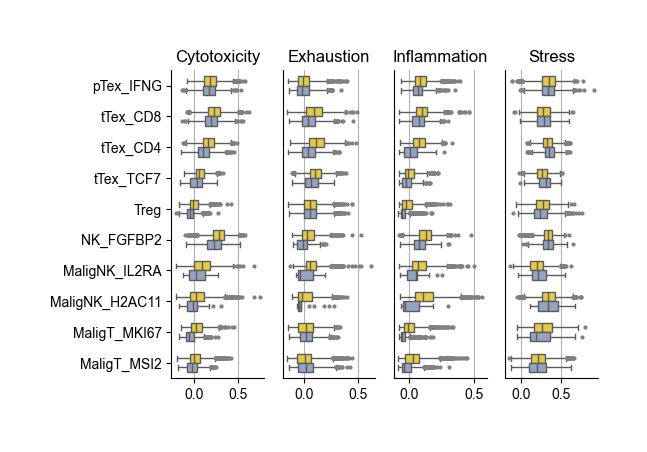

In [513]:
import seaborn as sns
order = ['T04_pTex_IFNG',  'T06_tTex_CD8', 
                              'T07_tTex_CD4','T05_tTex_TCF7', 'T08_Treg_FOXP3', 'NK5_FGFBP2', 
                              'NK7_Malig_IL2RA', 'NK8_Malig_H2AC11', 
                              'T12_Tprol_MKI67', 'T13_Malig_MSI2']
fig, ax = plt.subplots(1, 4, figsize=(5.5, 4))
flierprops = dict(markerfacecolor='grey', marker='.', markersize=4, linestyle='none', markeredgecolor='grey')
for i, x in enumerate(['cytotoxicity', 'exhaustion', 'inflammation', 'stress']):
  sns.boxplot(Tdf, x=x, y='cptype', orient='h', hue='treatment',order=order, 
              palette=['#ffd92f', '#8da0cb'], width=0.6,ax=ax[i], flierprops=flierprops, showfliers=True)
  if i > 0:
    ax[i].set_yticklabels([])
    ax[i].tick_params(axis='y', length=0)
  else:
    ax[i].set_yticklabels(['pTex_IFNG',  'tTex_CD8', 
                              'tTex_CD4','tTex_TCF7', 'Treg', 'NK_FGFBP2', 
                              'MaligNK_IL2RA', 'MaligNK_H2AC11', 
                              'MaligT_MKI67', 'MaligT_MSI2'])
  ax[i].set_xlabel('')
  x_min, x_max = ax[i].get_xlim()
  start = np.ceil(x_min *2) / 2
  xticks = np.arange(start, x_max, 0.5)
  ax[i].set_xticks(xticks)
  ax[i].xaxis.grid(True)
  ax[i].legend_.set_visible(False)
  ax[i].spines['top'].set_visible(False)
  ax[i].spines['right'].set_visible(False)
  ax[i].set_ylabel('')
  ax[i].set_title(x.capitalize())
fig.savefig(f"{figPath}/4c-scores_prepostICI.svg", bbox_inches='tight')